# Clustering

To do that, we first need to load the necessary packages.
__Important: Some of the packages have to be manually installed!__

In [97]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from datetime import datetime
from time import mktime
import h3
import h3pandas
from matplotlib.colors import ListedColormap
import contextily as ctx
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

## Data Preparation

We start by loading in the prepared dataset and take a look at it to see that its fine

In [98]:
file_path = "./data/"
taxi_data = pd.read_csv(f"{file_path}taxi_processed.csv", parse_dates=["trip_start_timestamp", "trip_end_timestamp"])
taxi_data.head(5)

,trip_id,taxi_id,trip_start_timestamp,trip_end_timestamp,pickup_census_tract,dropoff_census_tract,pickup_community_area,dropoff_community_area,trip_seconds,trip_miles,...,start_windspeed,end_temp,end_precip,end_windspeed,h3_6_pickup,h3_6_dropoff,h3_7_pickup,h3_7_dropoff,h3_8_pickup,h3_8_dropoff
0,505af6c6eb3cc5b3098f9c565af55e7ef6397d94,175a58299af3a8c883453259b9a0cfc45ccbbbe1a07883...,2021-01-01,2021-01-01 00:00:00,NaN,NaN,8.0,8.0,165.0,0.30,...,6.35,-1.33,0,6.35,862664c1fffffff,862664c1fffffff,872664c1effffff,872664c1effffff,882664c1edfffff,882664c1edfffff
1,b6a1c6f16a7f52cdfed0476891b7c8d58440011c,931225a382fc38a75212f9d358439aec0d9b50fdaf32ad...,2021-01-01,2021-01-01 00:45:00,NaN,NaN,14.0,22.0,2361.0,9.05,...,6.35,-1.33,0,6.35,862664ca7ffffff,862664ca7ffffff,872664d99ffffff,872664ca1ffffff,882664d993fffff,882664ca11fffff
2,a76c9cae097af5ff1dfef35b376a832f54d789ea,72920f6ebc5830d39039323cf78a316085444eb8f8b272...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,68.0,1800.0,9.80,...,6.35,-1.33,0,6.35,862664c1fffffff,862664cc7ffffff,872664c1effffff,872664cc2ffffff,882664c1edfffff,882664cc2bfffff
3,11b01b6ac8d706e3fe522ee17d1cb7bae4851c45,be435bc4d6744155b3272e9edded016bd4afb347774701...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,56.0,75.0,1260.0,9.20,...,6.35,-1.33,0,6.35,862664527ffffff,862664567ffffff,872664520ffffff,872664562ffffff,882664520bfffff,882664562dfffff
4,cdb55aa436f49734bec7dbe95605ef698819992d,a7aaa6374b9f88b5fd31a1106378dffccb77e1261bc57a...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,1.0,1555.0,8.80,...,6.35,-1.33,0,6.35,862664c1fffffff,862664d8fffffff,872664c1effffff,872664d8cffffff,882664c1edfffff,882664d8cdfffff


A simple timestep is not that useful in the context of clustering and we therefore split it up into hours, weekdays and month. Only hours are divided into start and end, because we assume that a several-day or even month long trip is rather unlikely

In [99]:
taxi_data["start_hour"] = pd.to_datetime(taxi_data["trip_start_timestamp"]).map(lambda x: x.hour)
taxi_data["end_hour"] = pd.to_datetime(taxi_data["trip_end_timestamp"]).map(lambda x: x.hour)
taxi_data["weekday"] = pd.to_datetime(taxi_data["trip_start_timestamp"]).map(lambda x: x.timetuple().tm_wday)
taxi_data["month"] = pd.to_datetime(taxi_data["trip_start_timestamp"]).map(lambda x: datetime.fromtimestamp(mktime(x.timetuple())).month)
taxi_data.head(5)

,trip_id,taxi_id,trip_start_timestamp,trip_end_timestamp,pickup_census_tract,dropoff_census_tract,pickup_community_area,dropoff_community_area,trip_seconds,trip_miles,...,h3_6_pickup,h3_6_dropoff,h3_7_pickup,h3_7_dropoff,h3_8_pickup,h3_8_dropoff,start_hour,end_hour,weekday,month
0,505af6c6eb3cc5b3098f9c565af55e7ef6397d94,175a58299af3a8c883453259b9a0cfc45ccbbbe1a07883...,2021-01-01,2021-01-01 00:00:00,NaN,NaN,8.0,8.0,165.0,0.30,...,862664c1fffffff,862664c1fffffff,872664c1effffff,872664c1effffff,882664c1edfffff,882664c1edfffff,0,0,4,1
1,b6a1c6f16a7f52cdfed0476891b7c8d58440011c,931225a382fc38a75212f9d358439aec0d9b50fdaf32ad...,2021-01-01,2021-01-01 00:45:00,NaN,NaN,14.0,22.0,2361.0,9.05,...,862664ca7ffffff,862664ca7ffffff,872664d99ffffff,872664ca1ffffff,882664d993fffff,882664ca11fffff,0,0,4,1
2,a76c9cae097af5ff1dfef35b376a832f54d789ea,72920f6ebc5830d39039323cf78a316085444eb8f8b272...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,68.0,1800.0,9.80,...,862664c1fffffff,862664cc7ffffff,872664c1effffff,872664cc2ffffff,882664c1edfffff,882664cc2bfffff,0,0,4,1
3,11b01b6ac8d706e3fe522ee17d1cb7bae4851c45,be435bc4d6744155b3272e9edded016bd4afb347774701...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,56.0,75.0,1260.0,9.20,...,862664527ffffff,862664567ffffff,872664520ffffff,872664562ffffff,882664520bfffff,882664562dfffff,0,0,4,1
4,cdb55aa436f49734bec7dbe95605ef698819992d,a7aaa6374b9f88b5fd31a1106378dffccb77e1261bc57a...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,1.0,1555.0,8.80,...,862664c1fffffff,862664d8fffffff,872664c1effffff,872664d8cffffff,882664c1edfffff,882664d8cdfffff,0,0,4,1


For clustering, we will use the h3 hexagons, so we have to remove any row with missing values in that column

In [100]:
taxi_data.isnull().sum()

trip_id                         0
taxi_id                         0
trip_start_timestamp            0
trip_end_timestamp              0
pickup_census_tract       2591527
dropoff_census_tract      2592090
pickup_community_area      112802
dropoff_community_area     248088
trip_seconds                    0
trip_miles                      0
trip_total                      0
company                         0
payment_type                    0
start_temp                      0
start_precip                    0
start_windspeed                 0
end_temp                        0
end_precip                      0
end_windspeed                   0
h3_6_pickup                112802
h3_6_dropoff               248088
h3_7_pickup                112802
h3_7_dropoff               248088
h3_8_pickup                112802
h3_8_dropoff               248088
start_hour                      0
end_hour                        0
weekday                         0
month                           0
dtype: int64

In [101]:
taxi_data = taxi_data[taxi_data["h3_7_pickup"].notna() & taxi_data["h3_7_dropoff"].notna()]
taxi_data.isnull().sum()

trip_id                         0
taxi_id                         0
trip_start_timestamp            0
trip_end_timestamp              0
pickup_census_tract       2286988
dropoff_census_tract      2286988
pickup_community_area           0
dropoff_community_area          0
trip_seconds                    0
trip_miles                      0
trip_total                      0
company                         0
payment_type                    0
start_temp                      0
start_precip                    0
start_windspeed                 0
end_temp                        0
end_precip                      0
end_windspeed                   0
h3_6_pickup                     0
h3_6_dropoff                    0
h3_7_pickup                     0
h3_7_dropoff                    0
h3_8_pickup                     0
h3_8_dropoff                    0
start_hour                      0
end_hour                        0
weekday                         0
month                           0
dtype: int64

In [102]:
taxi_data.reset_index(inplace=True)

Not any of this data is relevant, so we choose the features which we believe are useful for clustering. For the h3 resolution, we choose 7, as it is not too encompassing but also not completely sparse.

In [103]:
taxi_data_relevant = taxi_data[["trip_seconds", "trip_miles", "trip_total", "company", "payment_type", "start_temp", "start_precip", "start_windspeed", "h3_7_pickup", "h3_7_dropoff", "start_hour", "end_hour", "weekday", "month"]]
taxi_data_relevant.head(5)

,trip_seconds,trip_miles,trip_total,company,payment_type,start_temp,start_precip,start_windspeed,h3_7_pickup,h3_7_dropoff,start_hour,end_hour,weekday,month
0,165.0,0.30,5.00,Medallion Leasin,Cash,-1.33,0,6.35,872664c1effffff,872664c1effffff,0,0,4,1
1,2361.0,9.05,28.00,Flash Cab,Prcard,-1.33,0,6.35,872664d99ffffff,872664ca1ffffff,0,0,4,1
2,1800.0,9.80,29.00,Taxi Affiliation Services,Cash,-1.33,0,6.35,872664c1effffff,872664cc2ffffff,0,0,4,1
3,1260.0,9.20,34.33,Medallion Leasin,Credit Card,-1.33,0,6.35,872664520ffffff,872664562ffffff,0,0,4,1
4,1555.0,8.80,26.00,Flash Cab,Cash,-1.33,0,6.35,872664c1effffff,872664d8cffffff,0,0,4,1


We would also like to have the coordinates of these h3 hexagon centroids, as these are much more useful for distance calculation and therefore clustering than a categorical h3 string

In [104]:
taxi_data_relevant["start_lat"] = taxi_data_relevant["h3_7_pickup"].apply(lambda x: h3.h3_to_geo(x)[0])
taxi_data_relevant["start_long"] = taxi_data_relevant["h3_7_pickup"].apply(lambda x: h3.h3_to_geo(x)[1])
taxi_data_relevant["end_lat"] = taxi_data_relevant["h3_7_dropoff"].apply(lambda x: h3.h3_to_geo(x)[0])
taxi_data_relevant["end_long"] = taxi_data_relevant["h3_7_dropoff"].apply(lambda x: h3.h3_to_geo(x)[1])
taxi_data_relevant = taxi_data_relevant.drop(columns=["h3_7_pickup", "h3_7_dropoff"])
taxi_data_relevant.head(5)

,trip_seconds,trip_miles,trip_total,company,payment_type,start_temp,start_precip,start_windspeed,start_hour,end_hour,weekday,month,start_lat,start_long,end_lat,end_long
0,165.0,0.30,5.00,Medallion Leasin,Cash,-1.33,0,6.35,0,0,4,1,41.895400,-87.626394,41.895400,-87.626394
1,2361.0,9.05,28.00,Flash Cab,Prcard,-1.33,0,6.35,0,0,4,1,41.975593,-87.731171,41.923092,-87.697834
2,1800.0,9.80,29.00,Taxi Affiliation Services,Cash,-1.33,0,6.35,0,0,4,1,41.895400,-87.626394,41.777367,-87.648608
3,1260.0,9.20,34.33,Medallion Leasin,Credit Card,-1.33,0,6.35,0,0,4,1,41.796226,-87.778834,41.679863,-87.662130
4,1555.0,8.80,26.00,Flash Cab,Cash,-1.33,0,6.35,0,0,4,1,41.895400,-87.626394,42.004834,-87.663329


To make things easier, we split up continuous, geographical, ordinal and categorical column names into lists here

In [105]:
continuous_cols = ["trip_seconds", "trip_miles", "trip_total", "start_temp", "start_windspeed"]
geo_cols = ["start_lat", "start_long", "end_lat", "end_long"] # Also continuous, but special because geographic
ordinal_cols = ["start_hour", "end_hour", "weekday", "month"]
categorical_cols = ["company", "payment_type", "start_precip"]

## Data Scaling and Normalizing

We normalize the continuous (including geo) and ordinal taxi data to have a mean of 0 and a unit variance

In [106]:
scaler = StandardScaler()
taxi_data_transformed = pd.DataFrame(scaler.fit_transform(taxi_data_relevant[continuous_cols + geo_cols + ordinal_cols]), columns=taxi_data_relevant[continuous_cols + geo_cols + ordinal_cols].columns)
taxi_data_transformed.head(5)

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,end_hour,weekday,month
0,-1.012230,-0.788700,-0.959242,-1.601792,-0.202892,0.047900,0.552364,0.103253,0.505949,-2.653831,-2.648572,0.5651,-2.122213
1,1.565022,0.715318,0.417307,-1.601792,-0.202892,1.294476,-0.548088,0.550699,-0.548132,-2.653831,-2.648572,0.5651,-2.122213
2,0.906626,0.844234,0.477157,-1.601792,-0.202892,0.047900,0.552364,-1.803923,0.178184,-2.653831,-2.648572,0.5651,-2.122213
3,0.272875,0.741101,0.796157,-1.601792,-0.202892,-1.493754,-1.048686,-3.379388,-0.021328,-2.653831,-2.648572,0.5651,-2.122213
4,0.619091,0.672346,0.297607,-1.601792,-0.202892,0.047900,0.552364,1.871469,-0.039013,-2.653831,-2.648572,0.5651,-2.122213


Precipitation is also label encoded (but it was already a float with zero and ones as value, so it is only convenient for the data type conversion)

In [107]:
label_encoder = LabelEncoder()
taxi_data_transformed["start_precip"] = label_encoder.fit_transform(taxi_data_relevant["start_precip"])
taxi_data_transformed.head(5)

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,end_hour,weekday,month,start_precip
0,-1.012230,-0.788700,-0.959242,-1.601792,-0.202892,0.047900,0.552364,0.103253,0.505949,-2.653831,-2.648572,0.5651,-2.122213,0
1,1.565022,0.715318,0.417307,-1.601792,-0.202892,1.294476,-0.548088,0.550699,-0.548132,-2.653831,-2.648572,0.5651,-2.122213,0
2,0.906626,0.844234,0.477157,-1.601792,-0.202892,0.047900,0.552364,-1.803923,0.178184,-2.653831,-2.648572,0.5651,-2.122213,0
3,0.272875,0.741101,0.796157,-1.601792,-0.202892,-1.493754,-1.048686,-3.379388,-0.021328,-2.653831,-2.648572,0.5651,-2.122213,0
4,0.619091,0.672346,0.297607,-1.601792,-0.202892,0.047900,0.552364,1.871469,-0.039013,-2.653831,-2.648572,0.5651,-2.122213,0


The two categorical variables company and payment_type are one-hot encoded, so each value becomes a new column with 1 if this is the value of the specific sample

In [108]:
encoder = OneHotEncoder(drop='first') 
onehot = encoder.fit_transform(taxi_data_relevant[["company"]])
feature_name = encoder.categories_[0]
onehot_df = pd.DataFrame(onehot.toarray(), columns=feature_name[1:])
taxi_data_transformed = pd.concat([taxi_data_transformed, onehot_df], axis=1)

onehot = encoder.fit_transform(taxi_data_relevant[["payment_type"]])
feature_name = encoder.categories_[0]
onehot_df = pd.DataFrame(onehot.toarray(), columns=feature_name[1:])
taxi_data_transformed = pd.concat([taxi_data_transformed, onehot_df], axis=1)
taxi_data_transformed.head(5)

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,...,Top Cab,Top Cab Affiliation,U Taxicab,Credit Card,Dispute,Mobile,No Charge,Prcard,Prepaid,Unknown
0,-1.012230,-0.788700,-0.959242,-1.601792,-0.202892,0.047900,0.552364,0.103253,0.505949,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.565022,0.715318,0.417307,-1.601792,-0.202892,1.294476,-0.548088,0.550699,-0.548132,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.906626,0.844234,0.477157,-1.601792,-0.202892,0.047900,0.552364,-1.803923,0.178184,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.272875,0.741101,0.796157,-1.601792,-0.202892,-1.493754,-1.048686,-3.379388,-0.021328,-2.653831,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.619091,0.672346,0.297607,-1.601792,-0.202892,0.047900,0.552364,1.871469,-0.039013,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Check to see if the prepared and normalized data is still ok, but it seems to be

In [109]:
taxi_data_transformed.head(5)

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,...,Top Cab,Top Cab Affiliation,U Taxicab,Credit Card,Dispute,Mobile,No Charge,Prcard,Prepaid,Unknown
0,-1.012230,-0.788700,-0.959242,-1.601792,-0.202892,0.047900,0.552364,0.103253,0.505949,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.565022,0.715318,0.417307,-1.601792,-0.202892,1.294476,-0.548088,0.550699,-0.548132,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.906626,0.844234,0.477157,-1.601792,-0.202892,0.047900,0.552364,-1.803923,0.178184,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.272875,0.741101,0.796157,-1.601792,-0.202892,-1.493754,-1.048686,-3.379388,-0.021328,-2.653831,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.619091,0.672346,0.297607,-1.601792,-0.202892,0.047900,0.552364,1.871469,-0.039013,-2.653831,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [110]:
taxi_data_transformed.isnull().sum()

trip_seconds                                    0
trip_miles                                      0
trip_total                                      0
start_temp                                      0
start_windspeed                                 0
start_lat                                       0
start_long                                      0
end_lat                                         0
end_long                                        0
start_hour                                      0
end_hour                                        0
weekday                                         0
month                                           0
start_precip                                    0
2733 - 74600 Benny Jona                         0
3011 - 66308 JBL Cab Inc.                       0
312 Medallion Management Corp                   0
3556 - 36214 RC Andrews Cab                     0
3591 - 63480 Chuks Cab                          0
3620 - 52292 David K. Cab Corp.                 0


To not overload any visualization, we create a random sample with 10000 and 500 samples each.

In [111]:
taxi_sample_10000 = taxi_data_transformed.sample(10000, random_state=1)
taxi_sample_500 = taxi_sample_10000.sample(500, random_state=1)
taxi_sample_500.head(5)

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,...,Top Cab,Top Cab Affiliation,U Taxicab,Credit Card,Dispute,Mobile,No Charge,Prcard,Prepaid,Unknown
2630049,-0.501709,-0.049583,-0.420592,-0.733414,-0.988854,-0.903814,0.280542,0.103253,0.505949,-0.539918,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1105076,-0.484105,-0.621969,-0.794655,0.885168,1.959959,0.047900,0.552364,0.103253,0.505949,1.189647,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1881250,0.343292,-0.840267,0.955957,1.467604,2.061843,1.448053,-2.543042,1.398998,-1.040002,-0.155571,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2076308,1.188293,2.374036,2.140986,0.254195,1.156531,-0.269413,0.461675,1.558633,-3.842578,-0.347745,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3214016,-0.837362,-0.663222,-0.899392,-1.157579,-0.892792,-0.337446,0.151400,-0.297293,-0.057338,-0.347745,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Data Visualization

We take a first look at the features in a pairplot. To not make it too confusing, the continuous and ordinal features are plotted seperately and together once. 

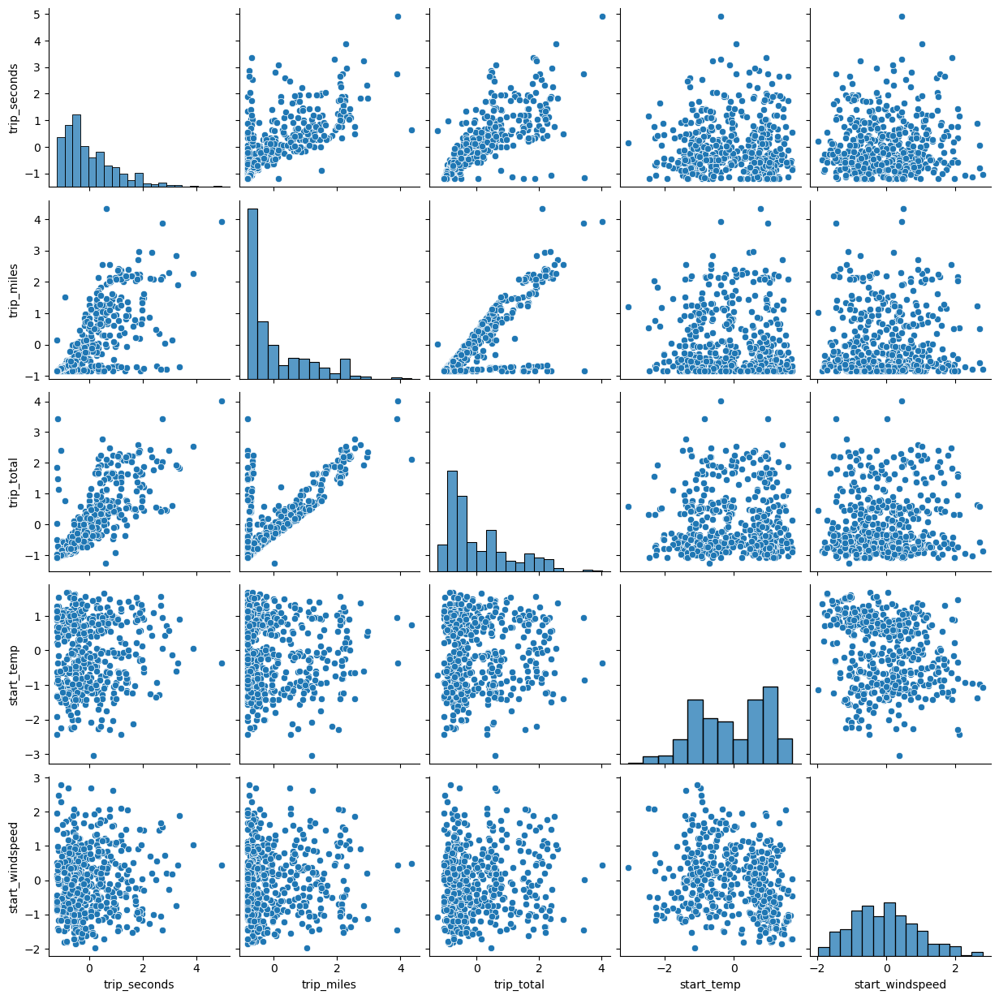

In [112]:
sns.pairplot(data=taxi_sample_500[continuous_cols])

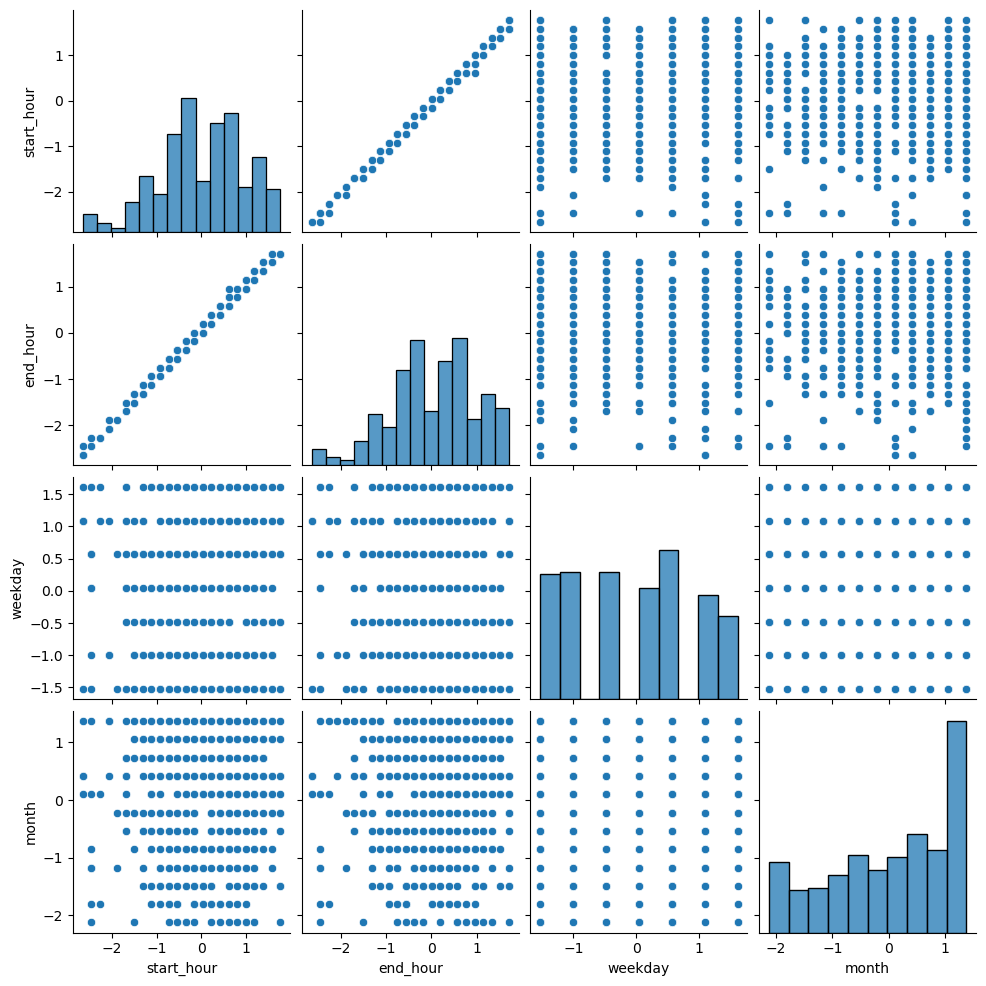

In [113]:
sns.pairplot(data=taxi_sample_500[ordinal_cols])

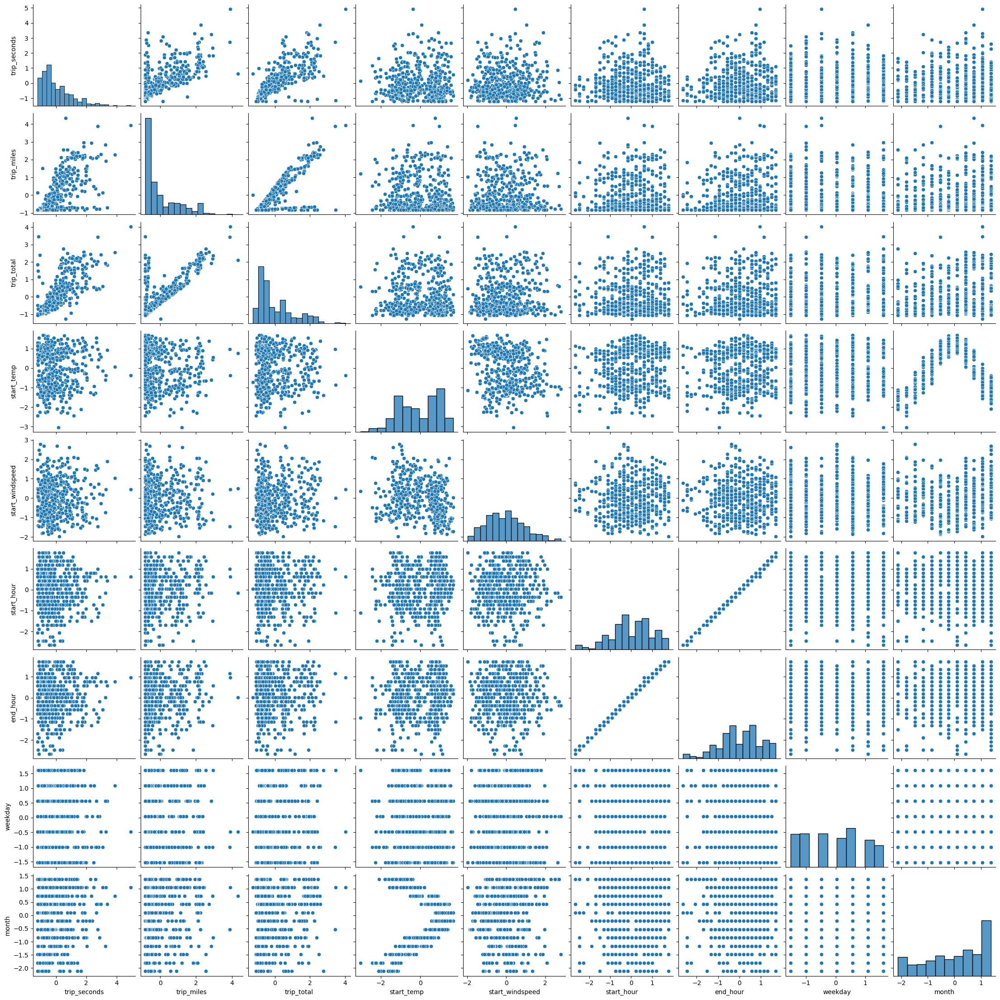

In [114]:
sns.pairplot(data=taxi_sample_500[continuous_cols + ordinal_cols])

This is a bit chaotic at first, but its already possible to see some common relationships in this...

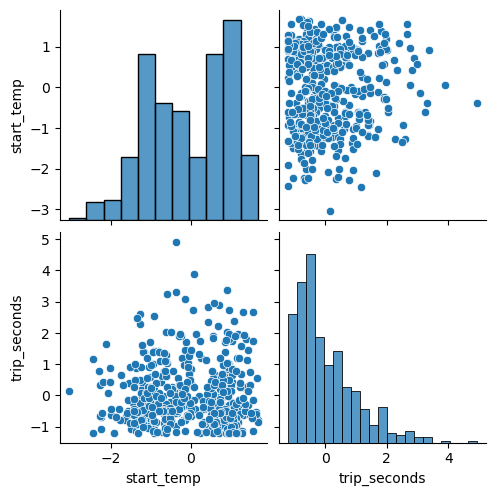

In [115]:
sns.pairplot(data=taxi_sample_500[["start_temp", "trip_seconds"]])

... like the relationship between start temperature and trip duration

It is also not really intuitive to plot geographical in such a pairplot, which is why we can seperate this from the pairplot to clean it up and display it correctly like coordinates. Due to the coordinates being normalized and with mean 0 however, displaying on a map doesn't make much sense and we use a scatterplot instead.

<AxesSubplot: xlabel='start_long', ylabel='start_lat'>

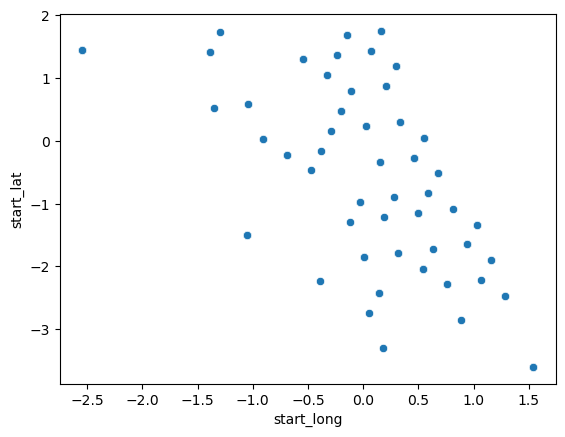

In [116]:
sns.scatterplot(data=taxi_sample_500[["start_lat", "start_long"]], x="start_long", y="start_lat")

## Hard Clustering (K-Means++)

We start the actual clustering by trying out the number of clusters optimal for this data set using the K-Means algorithm.

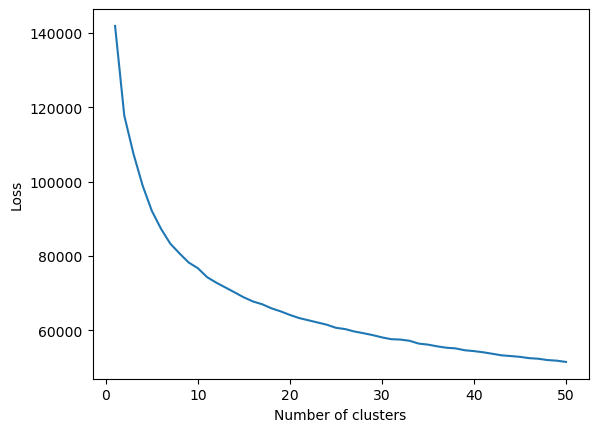

In [117]:
k_max = 50
clusters = []
losses = []

for k in range(k_max):
    model = KMeans(init="k-means++", n_clusters=k+1)
    model.fit(taxi_sample_10000)
    clusters.append(k+1)
    losses.append(model.inertia_)

plt.plot(clusters, losses)
plt.ylabel("Loss")
plt.xlabel("Number of clusters")
plt.show()

We zoom a bit further to see the optimal cluster numbers better.

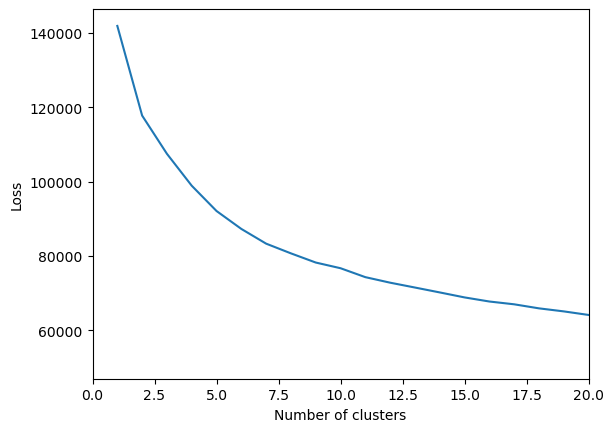

In [118]:
plt.plot(clusters, losses)
plt.xlim([0,20])
plt.ylabel("Loss")
plt.xlabel("Number of clusters")
plt.show()

Six clusters seems to be a pretty good spot, so we try that out for now and see how it looks.

In [119]:
means = KMeans(init="k-means++", n_clusters=6)
means.fit(taxi_sample_10000)
means.predict(taxi_sample_10000)

array([0, 1, 3, ..., 5, 2, 2])

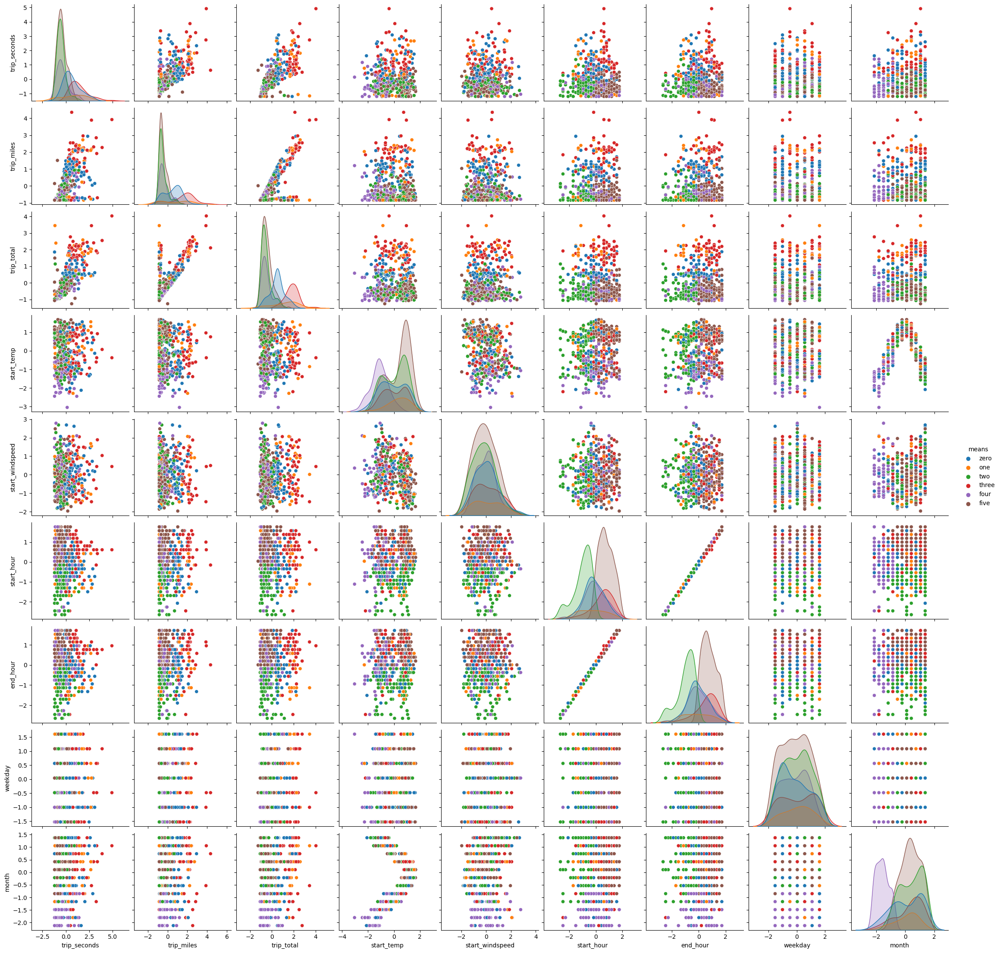

In [120]:
numbers = ["zero", "one", "two", "three", "four", "five"]
cmap = ListedColormap(["blue", "orange", "green", "red", "purple", "brown"])

taxi_sample_500["means"] = means.predict(taxi_sample_500)
taxi_sample_500["means"] = taxi_sample_500["means"].apply(lambda x: numbers[x])
sns.pairplot(data=taxi_sample_500[continuous_cols + ordinal_cols + ["means"]], hue="means", hue_order=numbers)

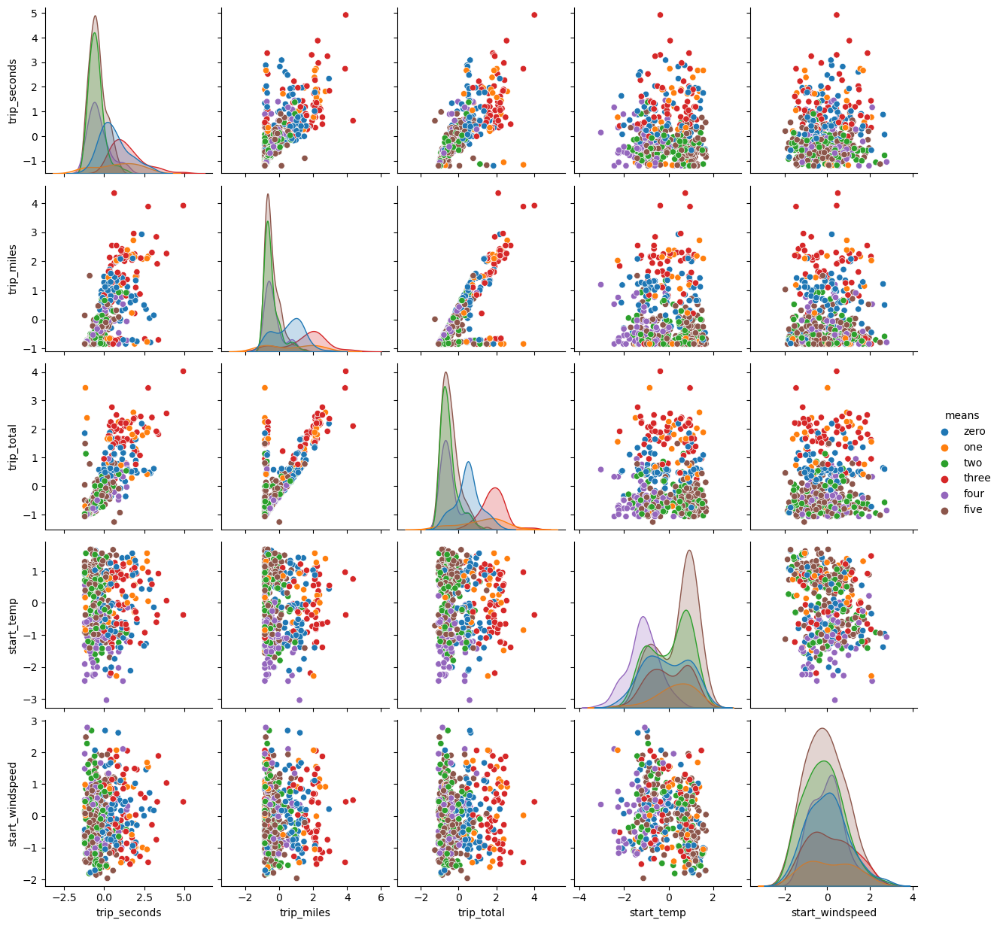

In [121]:
sns.pairplot(data=taxi_sample_500[continuous_cols + ["means"]], hue="means", hue_order=numbers)

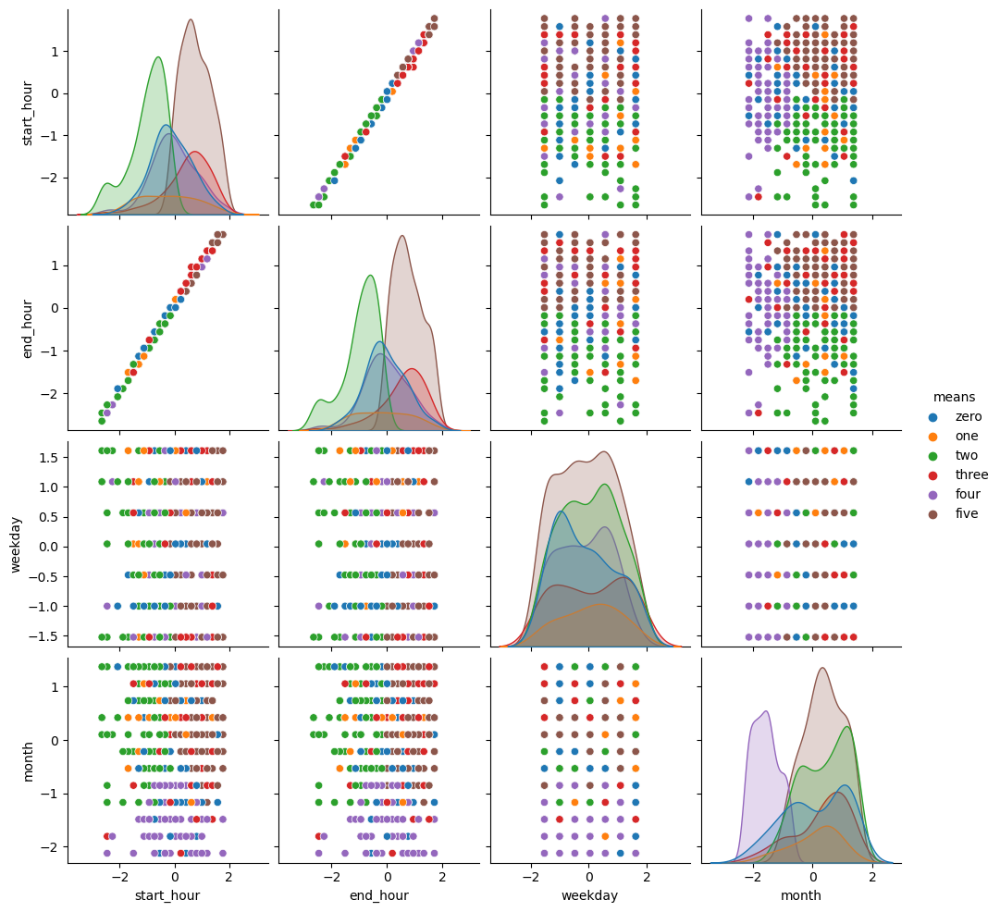

In [122]:
sns.pairplot(data=taxi_sample_500[ordinal_cols + ["means"]], hue="means", hue_order=numbers)

<AxesSubplot: xlabel='start_long', ylabel='start_lat'>

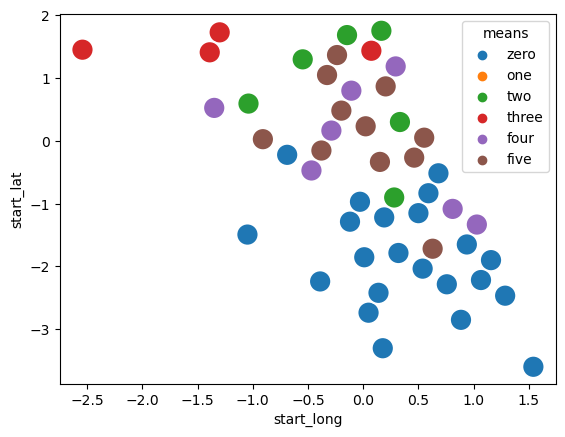

In [123]:
sns.scatterplot(data=taxi_sample_500[["start_lat", "start_long", "means"]], x="start_long", y="start_lat", hue="means", hue_order=numbers, s=250)

<AxesSubplot: >

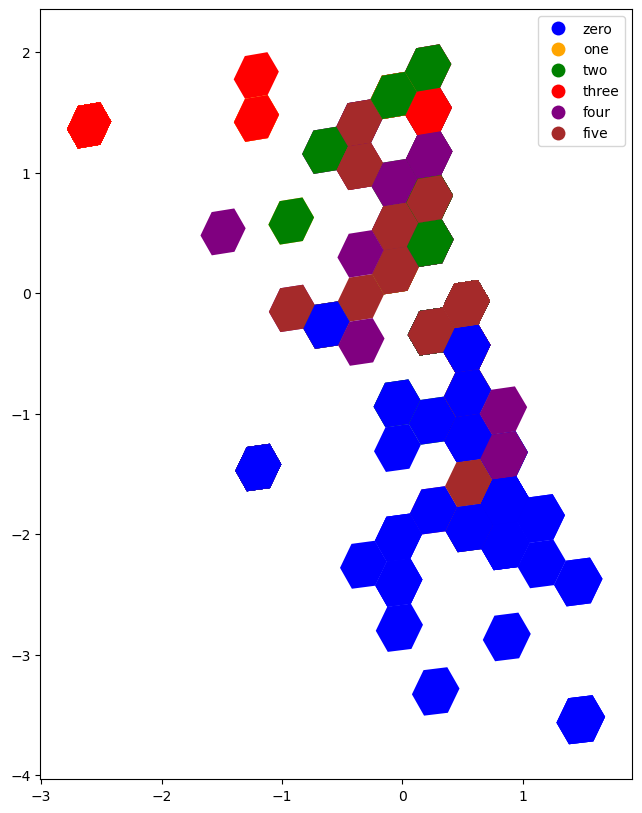

In [124]:
taxi_sample_500_gpd = taxi_sample_500.h3.geo_to_h3(lat_col="start_lat", lng_col="start_long", resolution=4)
taxi_sample_500_gpd = taxi_sample_500_gpd.h3.h3_to_geo_boundary()
taxi_sample_500_gpd.plot(legend=True, column="means", figsize=(10, 10), categories=numbers, cmap=cmap, missing_kwds = dict(color = "lightgrey",))

<AxesSubplot: xlabel='company_type', ylabel='count'>

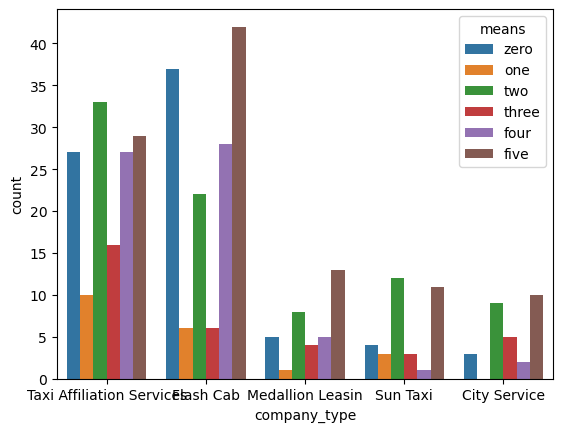

In [125]:
taxi_sample_500["company_type"] = (taxi_sample_500.loc[:, "2733 - 74600 Benny Jona": "U Taxicab"] == 1).idxmax(1)
sns.countplot(x='company_type', hue='means', data=taxi_sample_500, hue_order=numbers, order=taxi_sample_500.company_type.value_counts().iloc[:5].index)

<AxesSubplot: xlabel='payment', ylabel='count'>

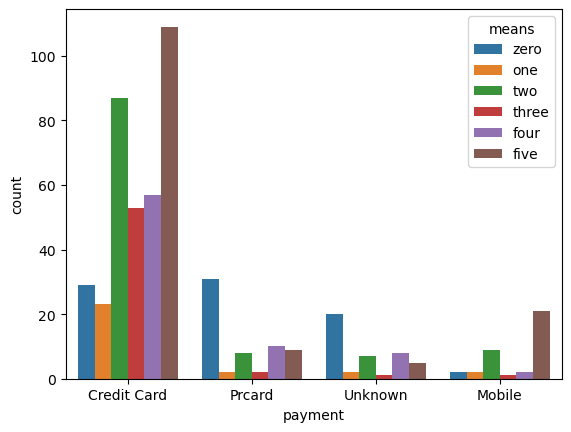

In [126]:
taxi_sample_500["payment"] = (taxi_sample_500.loc[:,"Credit Card": "Unknown"] == 1).idxmax(1)
sns.countplot(x='payment', hue='means', data=taxi_sample_500, hue_order=numbers, order=taxi_sample_500.payment.value_counts().iloc[:10].index)

There are already a few interesting observations one could make from these clusters, like the concentration of one cluster in the south or the two clusters with one having start times in the early day and one in the late day, but we still want to explore what options there are for increasing clustering performance. 

Perhaps soft clustering using Gaussian Mixture Models (GMMs) will give us different (better?) results?

As we have quite a number of features, a Principal Component Analysis could also be useful later for this purpose.

In [127]:
# CLEANING
taxi_sample_500.drop(columns=["company_type", "payment"], inplace=True, errors="ignore")

## Soft Clustering (GMMs)

The approach for soft clustering is similar to hard clustering, we start by looking at the optimal number of n_components by performing a grid search. Instead of loss, we however use BIC (Bayesian information criterion) and AIC (Akaike information criterion), which are common for evaluating GMMs

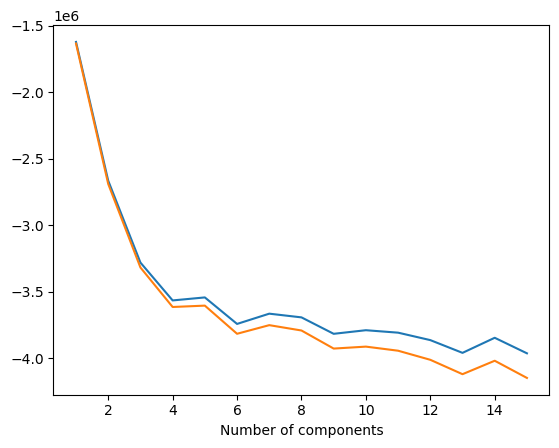

In [128]:
k_max = 15
bic = []
aic = []
components = []

for k in range(k_max):
    model = GaussianMixture(n_components=k+1)
    model.fit(taxi_sample_10000)
    components.append(k+1)
    bic.append(model.bic(taxi_sample_10000))
    aic.append(model.aic(taxi_sample_10000))

plt.plot(components, bic)
plt.plot(components, aic)
plt.xlabel("Number of components")
plt.show()

Four components seem like a good choice, so we will go with that

In [129]:
means = GaussianMixture(init_params="k-means++", n_components=4)
means.fit(taxi_sample_10000)
means.predict(taxi_sample_10000)

array([2, 3, 3, ..., 1, 3, 1], dtype=int64)

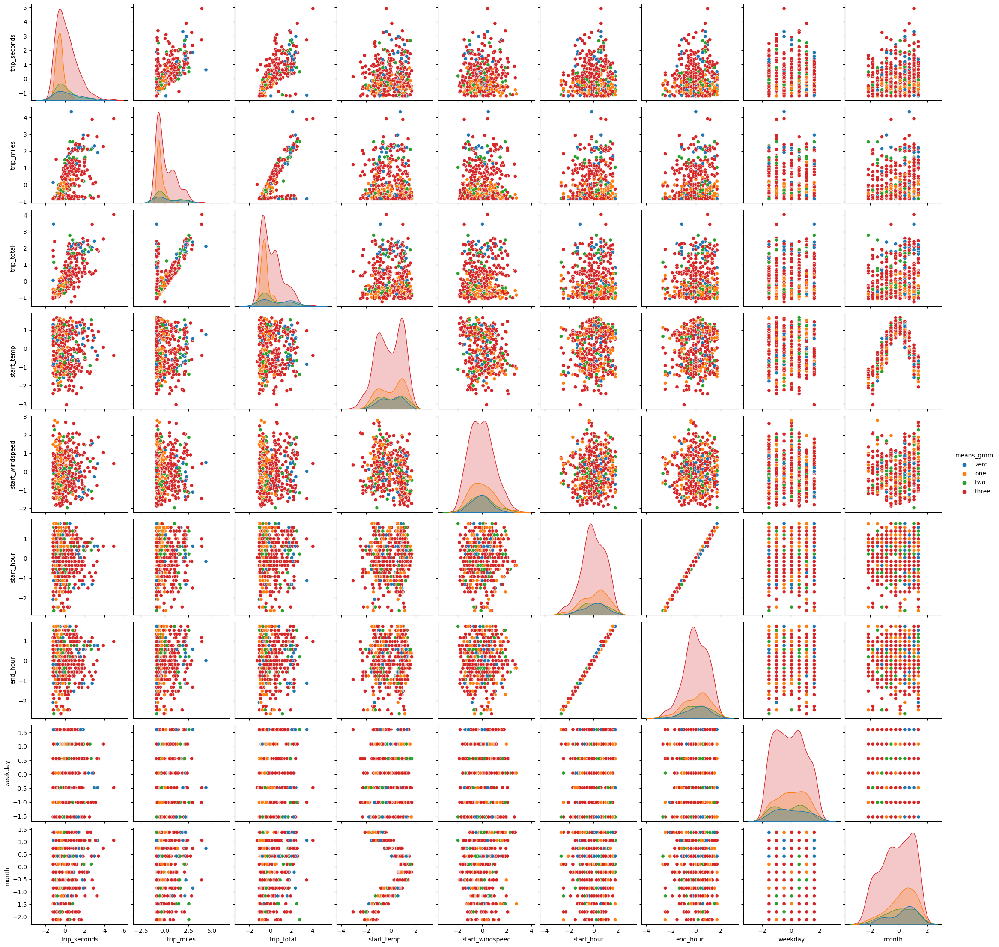

In [130]:
taxi_sample_500.drop(columns=["means", "means_gmm"], inplace=True, errors="ignore")
taxi_sample_500["means_gmm"] = means.predict(taxi_sample_500)
taxi_sample_500["means_gmm"] = taxi_sample_500["means_gmm"].apply(lambda x: numbers[x])
sns.pairplot(data=taxi_sample_500[continuous_cols + ordinal_cols + ["means_gmm"]], hue="means_gmm", hue_order=numbers[:4], palette="tab10")

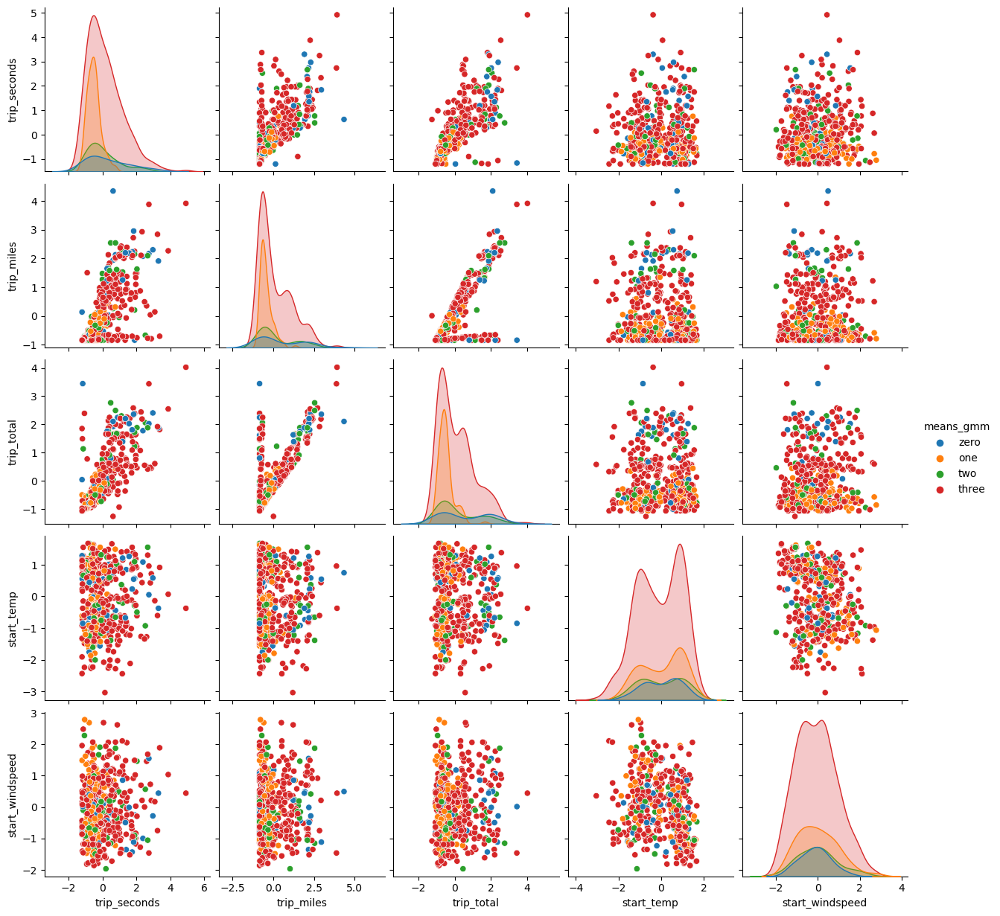

In [131]:
sns.pairplot(data=taxi_sample_500[continuous_cols + ["means_gmm"]], hue="means_gmm", hue_order=numbers[:4], palette="tab10")

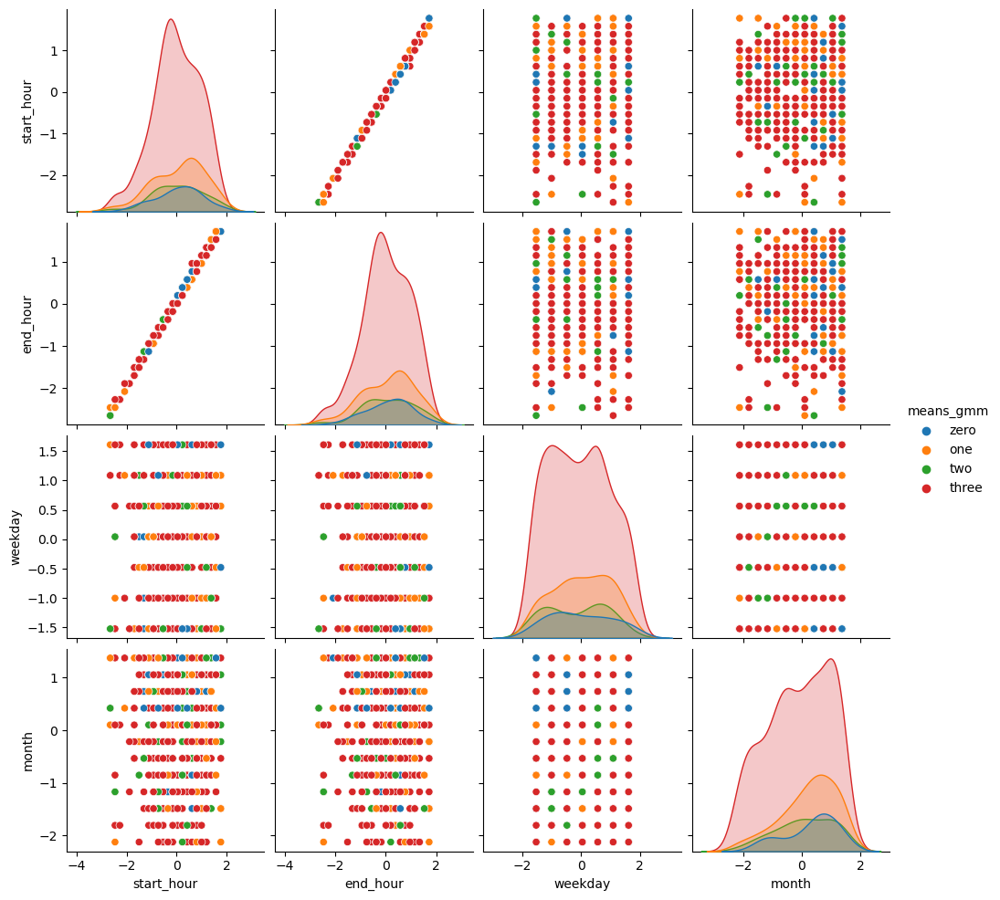

In [132]:
sns.pairplot(data=taxi_sample_500[ordinal_cols + ["means_gmm"]], hue="means_gmm", hue_order=numbers[:4], palette="tab10")

<AxesSubplot: xlabel='start_long', ylabel='start_lat'>

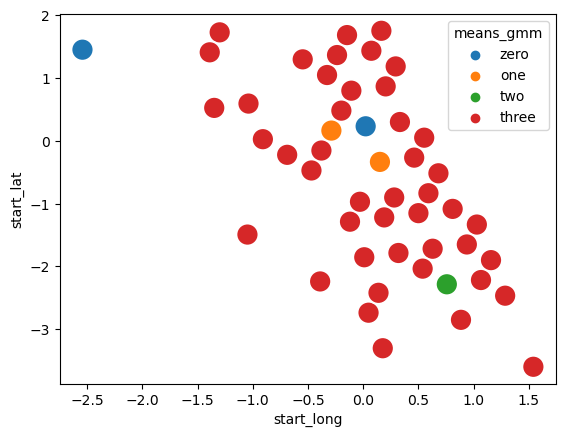

In [133]:
sns.scatterplot(data=taxi_sample_500[["start_lat", "start_long", "means_gmm"]], x="start_long", y="start_lat", hue="means_gmm", hue_order=numbers[:4], palette="tab10", s=250)

<AxesSubplot: >

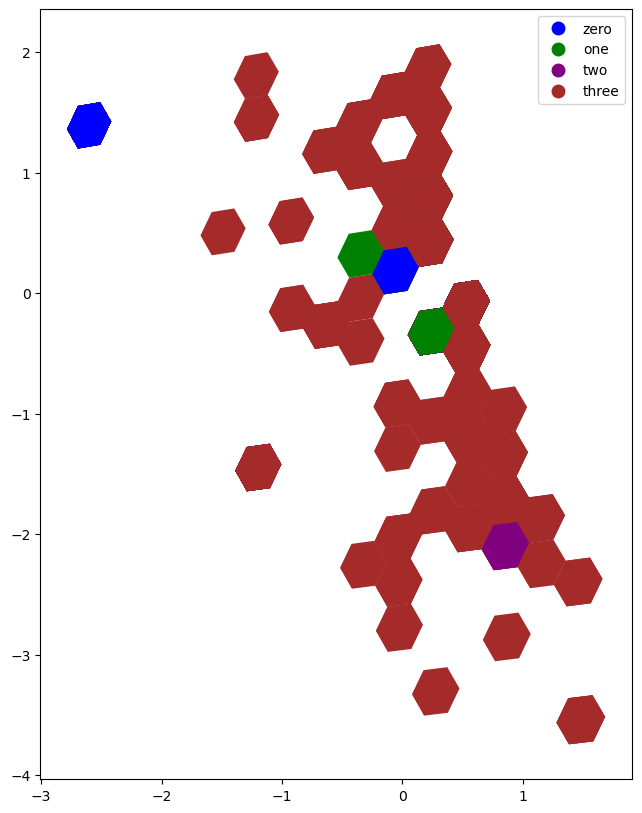

In [134]:
taxi_sample_500_gpd = taxi_sample_500.h3.geo_to_h3(lat_col="start_lat", lng_col="start_long", resolution=4)
taxi_sample_500_gpd = taxi_sample_500_gpd.h3.h3_to_geo_boundary()
taxi_sample_500_gpd.plot(legend=True, column="means_gmm", figsize=(10, 10), categories=numbers[:4], cmap=cmap, missing_kwds = dict(color = "lightgrey",))

<AxesSubplot: xlabel='company_type', ylabel='count'>

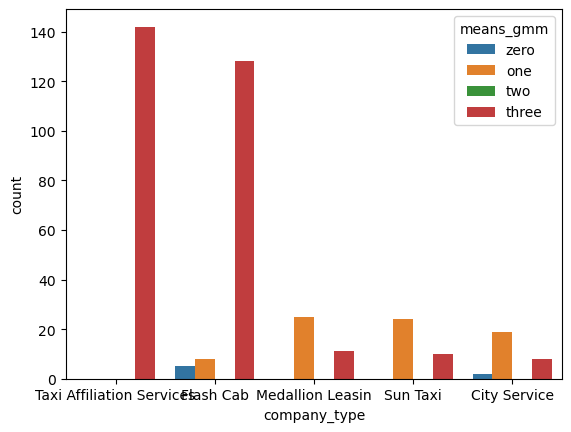

In [135]:
taxi_sample_500["company_type"] = (taxi_sample_500.loc[:, "2733 - 74600 Benny Jona": "U Taxicab"] == 1).idxmax(1)
sns.countplot(x='company_type', hue='means_gmm', data=taxi_sample_500, order=taxi_sample_500.company_type.value_counts().iloc[:5].index, hue_order=numbers[:4], palette="tab10")

<AxesSubplot: xlabel='payment', ylabel='count'>

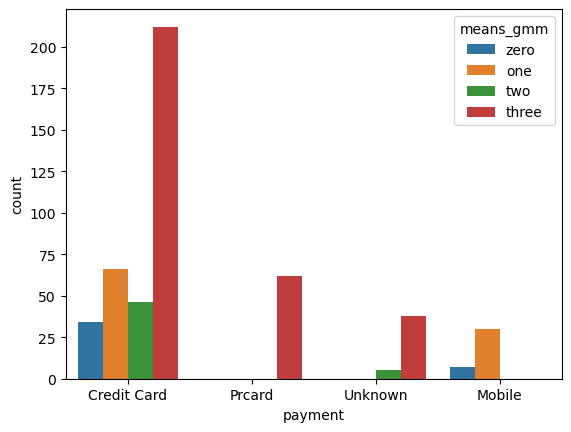

In [136]:
taxi_sample_500["payment"] = (taxi_sample_500.loc[:,"Credit Card": "Unknown"] == 1).idxmax(1)
sns.countplot(x='payment', hue='means_gmm', data=taxi_sample_500, order=taxi_sample_500.payment.value_counts().iloc[:10].index, hue_order=numbers[:4], palette="tab10")

It is already possible to draw some conclusions from these charts compared to the hard clustering, like the fact that soft clustering seems to, at least geographically, form much bigger clusters. But before we do that, we look at if we can improve predictive performance even more, by employing a Principal Component Analysis (PCA)

In [137]:
# CLEANING
taxi_sample_500.drop(columns=["company_type", "payment"], inplace=True, errors="ignore")

## Principal Component Analysis (PCA)

A Principal Component Analysis (PCA) makes sense when there are a lot of features and works to reduce the dimensionality of the feature set. We fit the bikesharing sample dataset to PCA and look at the variance explained by the most important feature first.

In [138]:
pca = PCA(n_components=1)
X_pca = pca.fit_transform(taxi_sample_10000)
pca.explained_variance_ratio_[0]

0.22196938022047163

A good amount of variance explained for PCA varies in sources from 80 to 95%, so we continue to use more PCA features to get to at least 85%

In [139]:
for i in range(50):
    pca = PCA(n_components=i)
    X_pca = pca.fit_transform(taxi_sample_10000)
    print(sum(pca.explained_variance_ratio_))
    if sum(pca.explained_variance_ratio_) >= 0.85:
        print(f"PCA Components: {i}")
        break

0
0.22196938022047186
0.3587961149735893
0.48252372603144084
0.5684933285349435
0.6441666326967286
0.7137668518482423
0.7765463909319177
0.8231414122937396
0.8543776681757211
PCA Components: 9


We take a look at this feature reduced dataset

In [140]:
taxi_pca = pd.DataFrame(X_pca, columns=["First PC", "Second PC", "Third PC", "Fourth PC", "Fifth PC", "Sixth PC", "Seventh PC", "Eighth PC", "Ninth PC"], index=taxi_sample_10000.index)
taxi_pca_500 = taxi_pca.loc[taxi_sample_500.index]
taxi_pca_500.head()

,First PC,Second PC,Third PC,Fourth PC,Fifth PC,Sixth PC,Seventh PC,Eighth PC,Ninth PC
2630049,-0.990055,0.725744,0.499473,-0.268813,-0.244485,-0.564236,-0.045820,-1.503032,-0.194936
1105076,-1.110994,-1.774600,-0.680145,0.623426,-0.821880,0.868157,0.120268,1.985480,0.373081
1881250,2.242534,0.342926,-2.258130,0.550197,-0.844508,-1.541923,-0.734875,2.142200,-1.115495
2076308,3.545568,1.057276,-0.532782,0.715664,-0.543426,-0.578838,3.784993,0.482497,-0.359556
3214016,-1.335907,0.424458,-0.281288,0.025934,-0.778584,0.331609,-0.025956,-1.878326,-0.280528


Then we do the same thing from above where we look for the optimal amount of clusters, first for hard clustering

### K-Means PCA

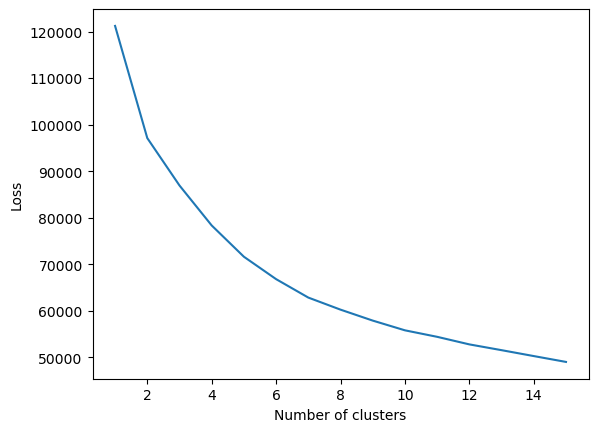

In [141]:
pca_clusters = []
pca_losses = []

for i in range(k_max):
    model = KMeans(init="k-means++", n_clusters=i+1)
    model.fit(X_pca)
    pca_clusters.append(i+1)
    pca_losses.append(model.inertia_)
    
plt.plot(pca_clusters, pca_losses)
plt.ylabel("Loss")
plt.xlabel("Number of clusters")
plt.show()

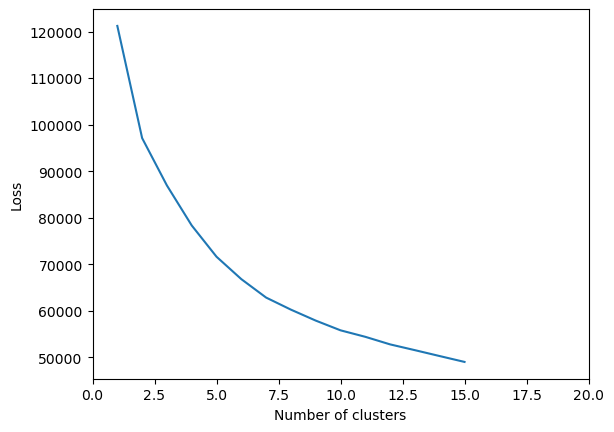

In [142]:
plt.plot(pca_clusters, pca_losses)
plt.xlim([0,20])
plt.ylabel("Loss")
plt.xlabel("Number of clusters")
plt.show()

Six clusters still seems to be a solid choice and we appear to have managed to increase predictive performance, as our loss at six clusters reduced from about 80000 to 60000

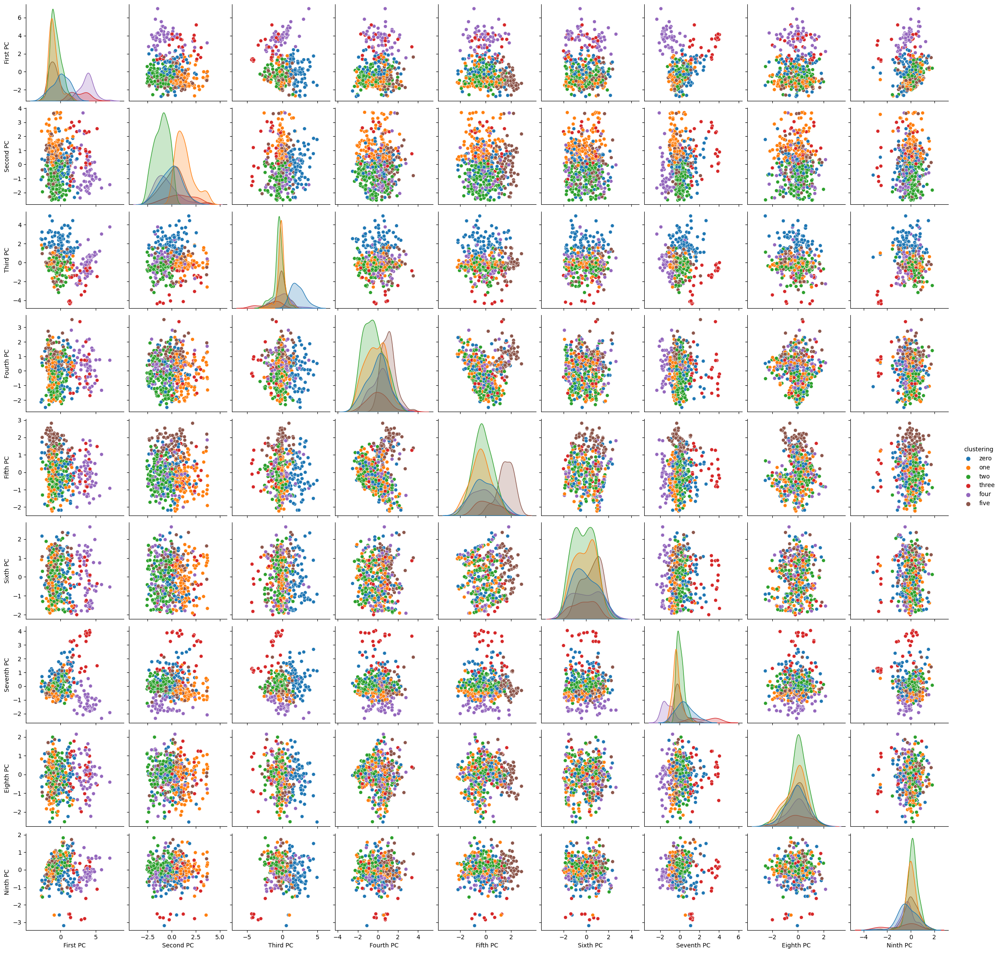

In [143]:
kmeans = KMeans(init="k-means++", n_clusters=6)
kmeans.fit(taxi_pca)
numbers = ["zero", "one", "two", "three", "four", "five"]
taxi_pca_500["clustering"] = kmeans.predict(taxi_pca_500)
taxi_pca_500["clustering"] = taxi_pca_500["clustering"].apply(lambda x: numbers[x])
sns.pairplot(data=taxi_pca_500, hue="clustering", hue_order=numbers)

Before we interpret these results, we will do the same thing for soft clustering with GMMs

### GMM PCA

Like we did with hard clustering, we do the same thing from above again, this time looking for best BIC and AIC in the PCA-reduced dataset

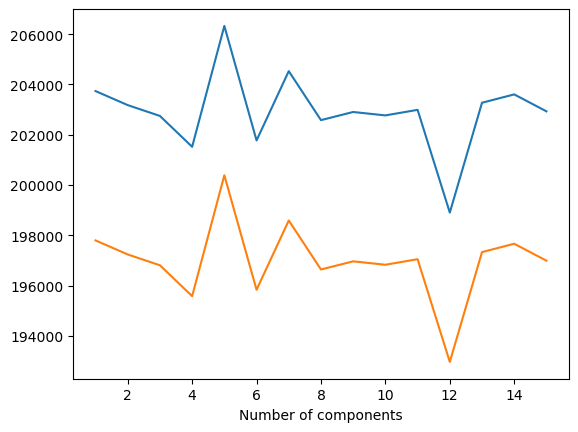

In [174]:
bic = []
aic = []
pca_components = []

for i in range(15):
    model = GaussianMixture(n_components=k+1)
    model.fit(X_pca)
    pca_components.append(i+1)
    bic.append(model.bic(X_pca))
    aic.append(model.aic(X_pca))
    
plt.plot(pca_components, bic, label="bic")
plt.plot(pca_components, aic, label="aic")
plt.xlabel("Number of components")
plt.show()

Interestingly, the graph here seems to not really go down or up in a predictable manner, so we stick to our choice of four components from before

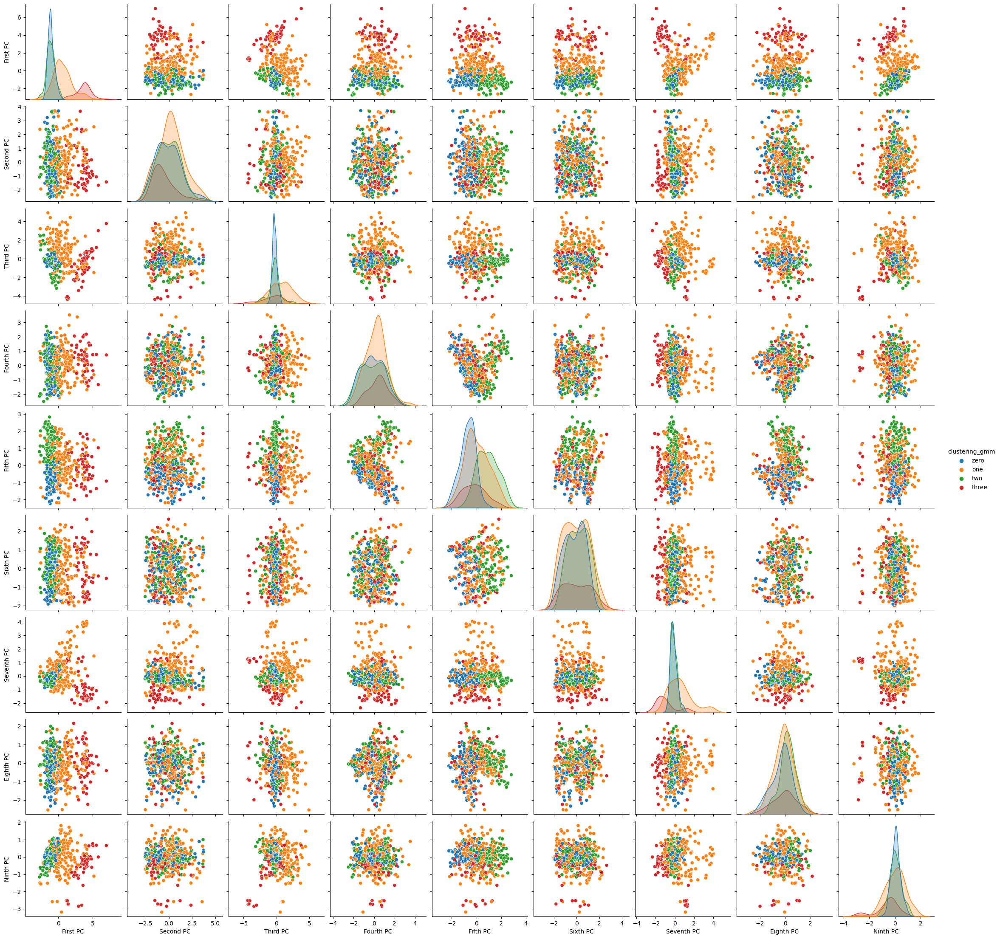

In [175]:
gmm = GaussianMixture(init_params="k-means++", n_components=4)
gmm.fit(taxi_pca)
taxi_pca_500["clustering_gmm"] = gmm.predict(taxi_pca_500.drop(columns=["means", "means_gmm", "clustering", "clustering_gmm"], errors="ignore"))
taxi_pca_500["clustering_gmm"] = taxi_pca_500["clustering_gmm"].apply(lambda x: numbers[x])
sns.pairplot(data=taxi_pca_500, hue="clustering_gmm", hue_order=numbers[:4], palette="tab10")

As a special case for soft clustering, we save the probabilities of each sample belonging to a cluster for later visualization

In [176]:
taxi_pca_500_probabilities = pd.DataFrame(gmm.predict_proba(taxi_pca_500.drop(columns=["means", "means_gmm", "clustering", "clustering_gmm"], errors="ignore")))
taxi_pca_500_probabilities

,0,1,2,3
0,9.830072e-01,1.699281e-02,1.652238e-12,8.934682e-143
1,9.025817e-05,1.386663e-03,9.985231e-01,6.604239e-117
2,4.371953e-90,5.277415e-04,4.040207e-29,9.994723e-01
3,7.989036e-56,1.000000e+00,1.323354e-48,8.721411e-86
4,9.995447e-01,4.553301e-04,1.286259e-19,3.618746e-129
...,...,...,...,...
495,2.671036e-16,1.000000e+00,1.571540e-12,3.236736e-39
496,3.781039e-18,1.000000e+00,1.117675e-17,2.449834e-187
497,9.526447e-01,4.697723e-02,3.780296e-04,1.485388e-102
498,8.277296e-01,1.219010e-03,1.710514e-01,2.750038e-124


Before we derive any conclusions, we retransform the dataset into the original variable dimension by denormalizing. 

## Denormalizing

First, we put the clustering labels on the original sample dataset, inverse transform the continuous, geo and ordinal columns and put the geographical features back in one column.

In [177]:
taxi_sample_500["clustering"] = taxi_pca_500["clustering"]
taxi_sample_500["clustering_gmm"] = taxi_pca_500["clustering_gmm"]
taxi_sample_retransformed = pd.DataFrame(scaler.inverse_transform(taxi_sample_500[continuous_cols + geo_cols + ordinal_cols]), columns=taxi_sample_500[continuous_cols + geo_cols + ordinal_cols].columns)
taxi_sample_retransformed["company_type"] = (taxi_sample_500.reset_index().loc[:, "2733 - 74600 Benny Jona": "U Taxicab"] == 1).idxmax(1)
taxi_sample_retransformed["payment"] = (taxi_sample_500.reset_index().loc[:,"Credit Card": "Unknown"] == 1).idxmax(1)
taxi_sample_retransformed

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,end_hour,weekday,month,company_type,payment
0,600.0,4.60,14.00,6.90,3.65,41.834177,-87.652275,41.895400,-87.626394,11.0,11.0,2.0,11.0,Taxi Affiliation Services,Unknown
1,615.0,1.27,7.75,22.24,13.78,41.895400,-87.626394,41.895400,-87.626394,20.0,20.0,5.0,6.0,Sun Taxi,Credit Card
2,1320.0,0.00,37.00,27.76,14.13,41.985472,-87.921115,41.975593,-87.731171,13.0,13.0,1.0,9.0,Taxi Affiliation Services,Credit Card
3,2040.0,18.70,56.80,16.26,11.02,41.874988,-87.635029,41.985472,-87.921115,12.0,13.0,3.0,9.0,Taxi Affiliation Services,Credit Card
4,314.0,1.03,6.00,2.88,3.98,41.870611,-87.664571,41.870611,-87.664571,12.0,13.0,4.0,12.0,Flash Cab,Credit Card
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1052.0,8.69,24.00,11.84,9.67,42.000438,-87.692949,41.911442,-87.647322,5.0,5.0,3.0,10.0,Flash Cab,Prcard
496,1082.0,11.41,29.00,8.98,3.43,41.858950,-87.614120,41.720596,-87.644951,14.0,14.0,3.0,11.0,Flash Cab,Prcard
497,20.0,0.00,45.94,17.55,7.30,41.874988,-87.635029,41.874988,-87.635029,18.0,18.0,5.0,9.0,Flash Cab,Credit Card
498,1.0,0.00,3.25,24.57,4.88,41.895400,-87.626394,41.895400,-87.626394,18.0,18.0,3.0,8.0,Flash Cab,Credit Card


In [178]:
taxi_sample_retransformed["clustering"] = taxi_sample_500.reset_index()["clustering"]
taxi_sample_retransformed["clustering_gmm"] = taxi_sample_500.reset_index()["clustering_gmm"]
taxi_sample_retransformed

,trip_seconds,trip_miles,trip_total,start_temp,start_windspeed,start_lat,start_long,end_lat,end_long,start_hour,end_hour,weekday,month,company_type,payment,clustering,clustering_gmm
0,600.0,4.60,14.00,6.90,3.65,41.834177,-87.652275,41.895400,-87.626394,11.0,11.0,2.0,11.0,Taxi Affiliation Services,Unknown,one,zero
1,615.0,1.27,7.75,22.24,13.78,41.895400,-87.626394,41.895400,-87.626394,20.0,20.0,5.0,6.0,Sun Taxi,Credit Card,two,two
2,1320.0,0.00,37.00,27.76,14.13,41.985472,-87.921115,41.975593,-87.731171,13.0,13.0,1.0,9.0,Taxi Affiliation Services,Credit Card,four,three
3,2040.0,18.70,56.80,16.26,11.02,41.874988,-87.635029,41.985472,-87.921115,12.0,13.0,3.0,9.0,Taxi Affiliation Services,Credit Card,three,one
4,314.0,1.03,6.00,2.88,3.98,41.870611,-87.664571,41.870611,-87.664571,12.0,13.0,4.0,12.0,Flash Cab,Credit Card,one,zero
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,1052.0,8.69,24.00,11.84,9.67,42.000438,-87.692949,41.911442,-87.647322,5.0,5.0,3.0,10.0,Flash Cab,Prcard,one,one
496,1082.0,11.41,29.00,8.98,3.43,41.858950,-87.614120,41.720596,-87.644951,14.0,14.0,3.0,11.0,Flash Cab,Prcard,zero,one
497,20.0,0.00,45.94,17.55,7.30,41.874988,-87.635029,41.874988,-87.635029,18.0,18.0,5.0,9.0,Flash Cab,Credit Card,two,zero
498,1.0,0.00,3.25,24.57,4.88,41.895400,-87.626394,41.895400,-87.626394,18.0,18.0,3.0,8.0,Flash Cab,Credit Card,two,zero


Then we finally visualize the results with the real data, first for the hard clustering with K-Means++

## Results and Intepretation: Hard Clustering with K-Means++

We take a look at the final results.
The continuous and ordinal columns are plotted in a pairplot, the geographical ones on a map and the top categorical values in a bar chart.

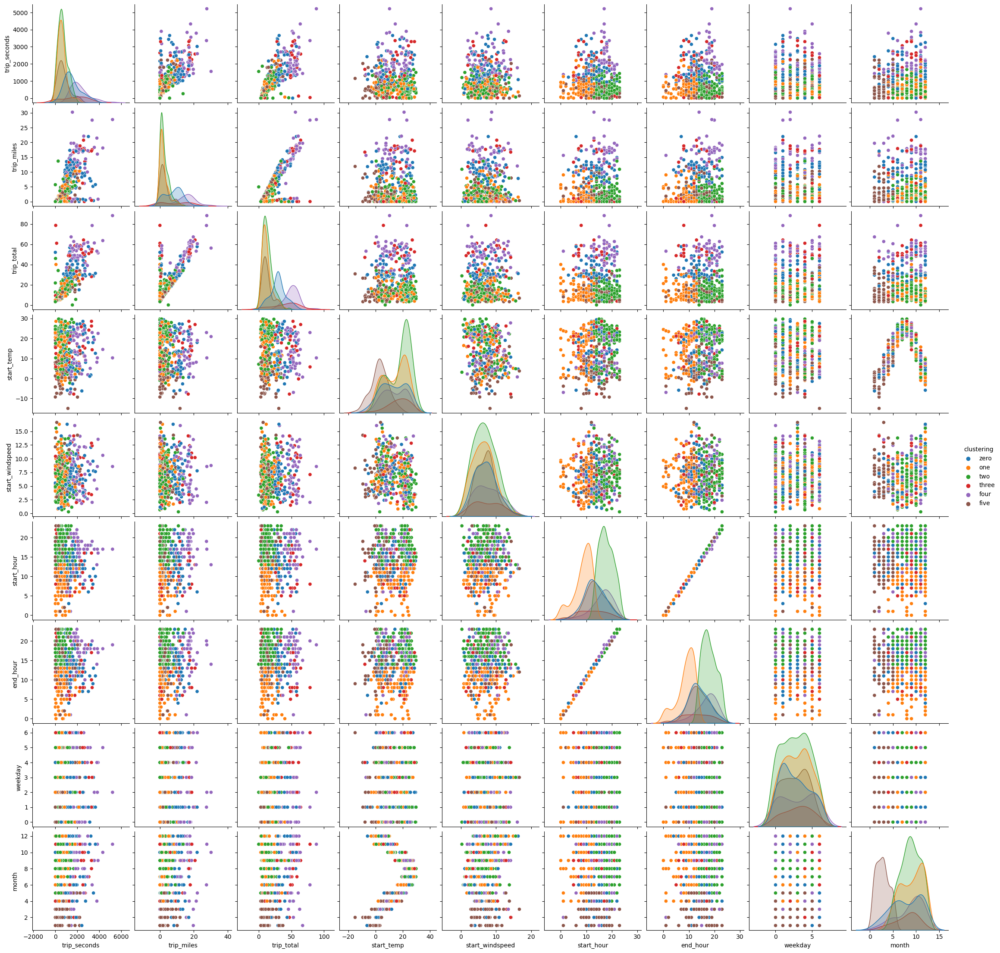

In [179]:
sns.pairplot(data=taxi_sample_retransformed[continuous_cols + ordinal_cols + ["clustering"]], hue="clustering", hue_order=numbers)

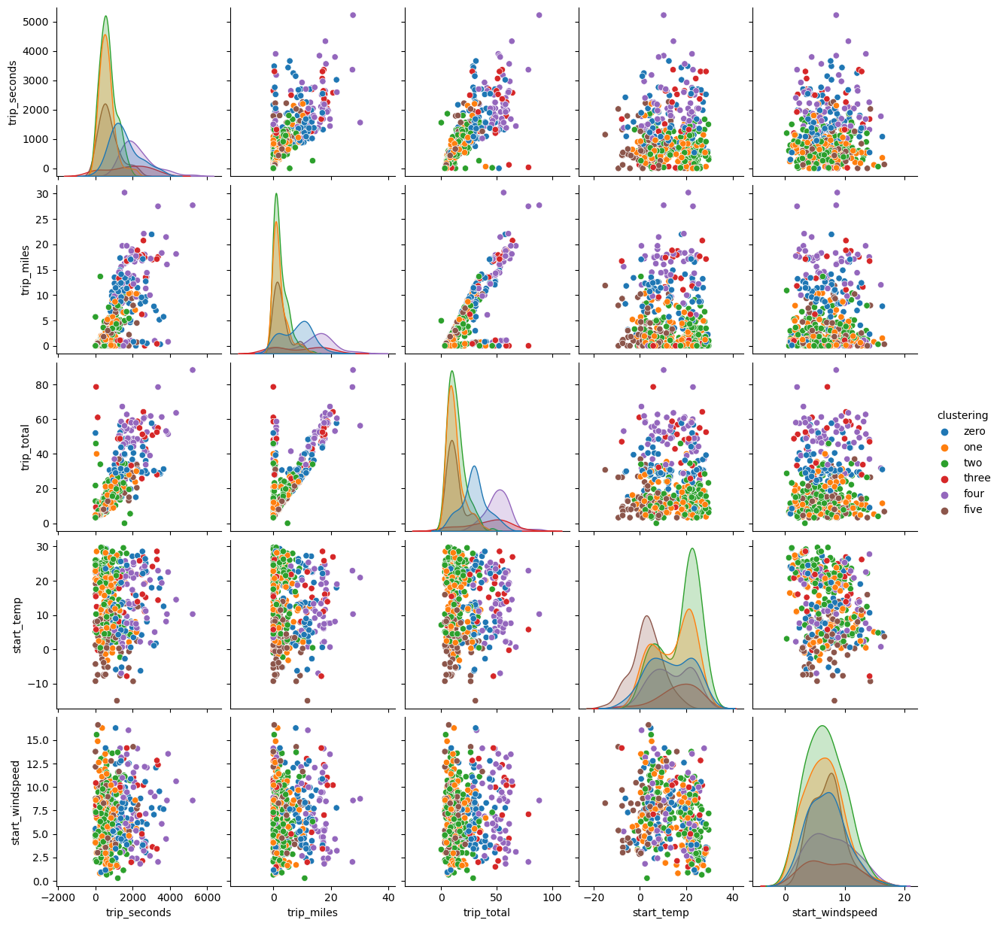

In [180]:
sns.pairplot(data=taxi_sample_retransformed[continuous_cols + ["clustering"]], hue="clustering", hue_order=numbers)

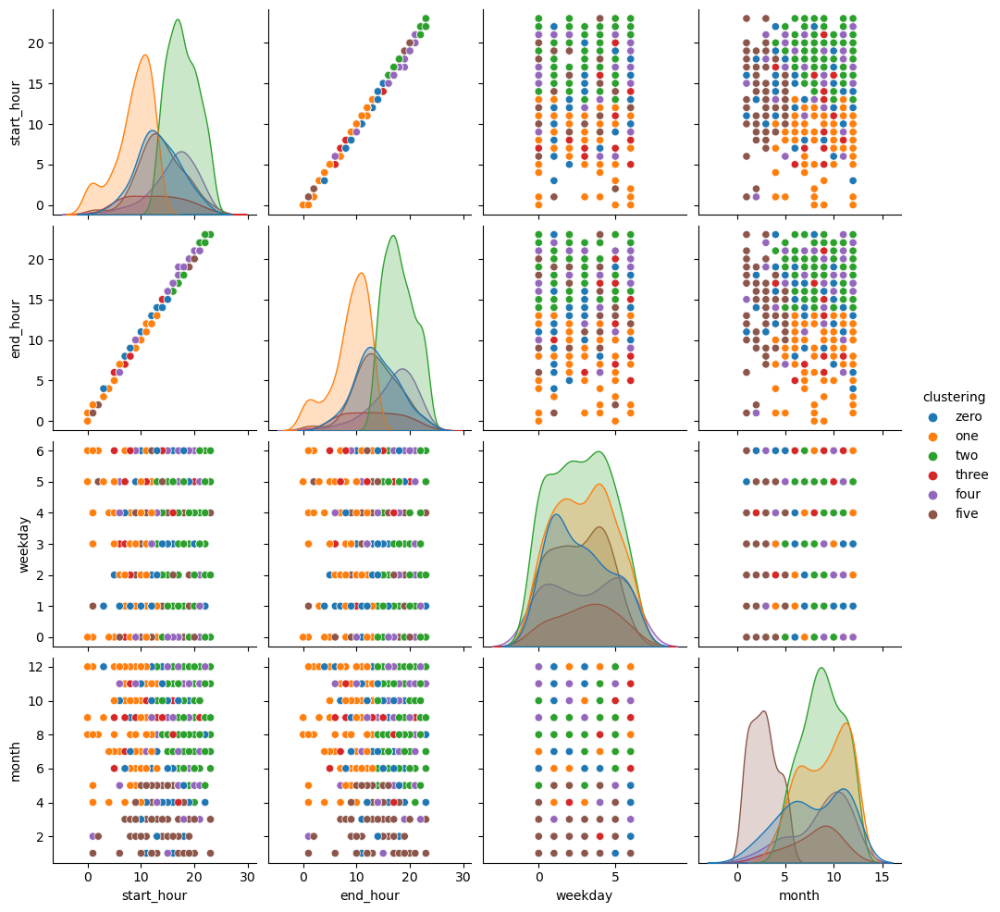

In [181]:
sns.pairplot(data=taxi_sample_retransformed[ordinal_cols + ["clustering"]], hue="clustering", hue_order=numbers)

In [182]:
taxi_sample_locations = taxi_sample_retransformed[["start_lat", "start_long", "clustering"]]
colors = {"zero" : "blue", "one" : "orange", "two" : "green", "three" : "red", "four" : "purple", "five" : "brown"}
tmap = folium.Map(location=[taxi_sample_locations.start_lat.mean(), taxi_sample_locations.start_long.mean()], zoom_start=10, control_scale=True)
def plot_points(point):
    folium.CircleMarker(location=[point.start_lat, point.start_long],
                        radius=5,
                        weight=10,
                       color=colors[point.clustering]).add_to(tmap)
taxi_sample_locations.apply(plot_points, axis=1)
tmap

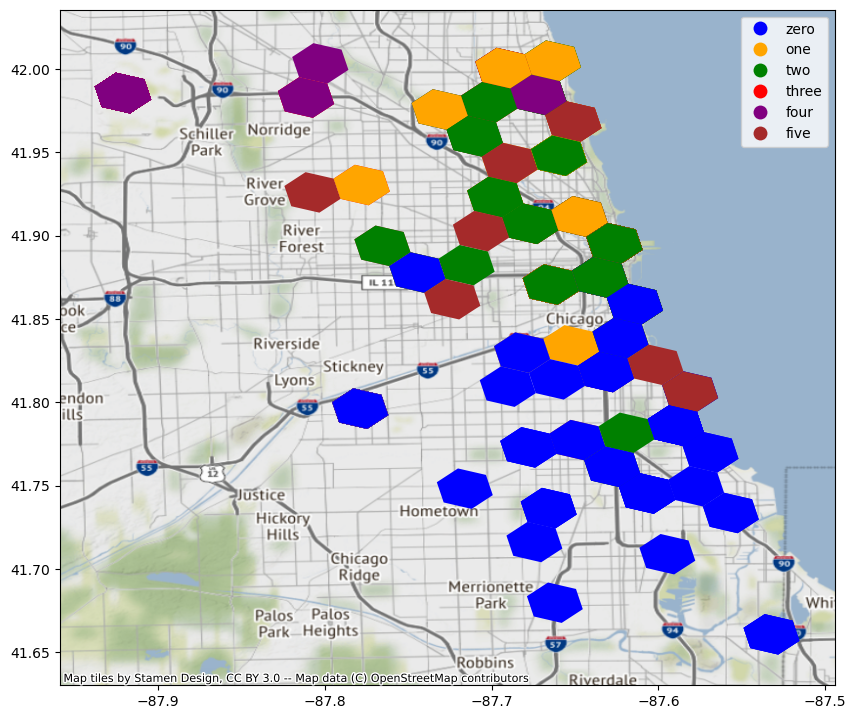

In [183]:
taxi_sample_retransformed_gpd = taxi_sample_retransformed.h3.geo_to_h3(lat_col="start_lat", lng_col="start_long", resolution=7)
taxi_sample_retransformed_gpd = taxi_sample_retransformed_gpd.h3.h3_to_geo_boundary()
ax = taxi_sample_retransformed_gpd.plot(legend=True, column="clustering", figsize=(10, 10), categories=numbers, cmap=cmap, missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

In [184]:
taxi_sample_locations = taxi_sample_retransformed[["end_lat", "end_long", "clustering"]]
tmap = folium.Map(location=[taxi_sample_locations.end_lat.mean(), taxi_sample_locations.end_long.mean()], zoom_start=10, control_scale=True)
def plot_points(point):
    folium.CircleMarker(location=[point.end_lat, point.end_long],
                        radius=5,
                        weight=10,
                       color=colors[point.clustering]).add_to(tmap)
taxi_sample_locations.apply(plot_points, axis=1)
tmap

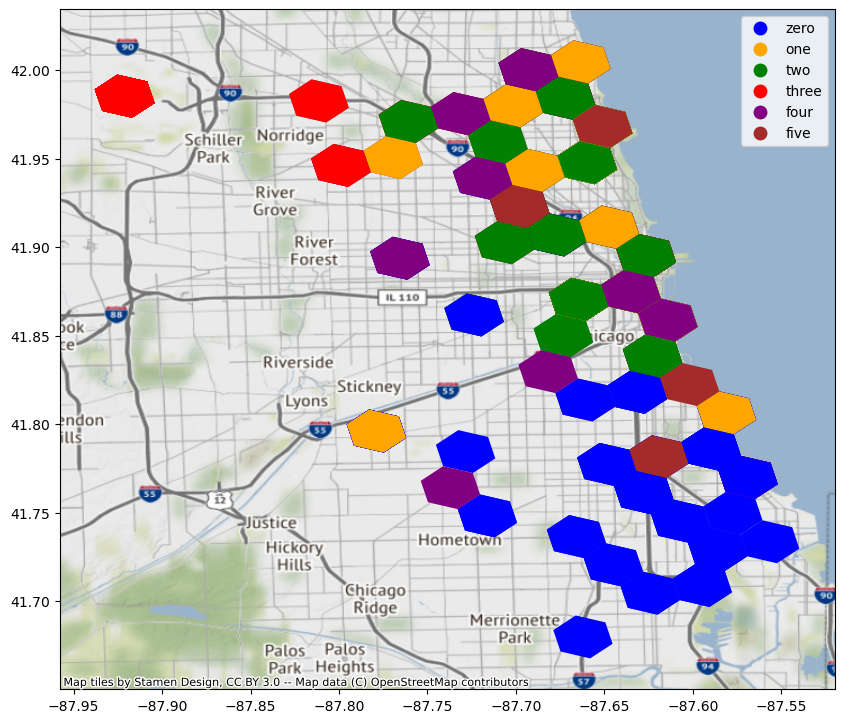

In [185]:
taxi_sample_retransformed_gpd = taxi_sample_retransformed.h3.geo_to_h3(lat_col="end_lat", lng_col="end_long", resolution=7)
taxi_sample_retransformed_gpd = taxi_sample_retransformed_gpd.h3.h3_to_geo_boundary()
ax = taxi_sample_retransformed_gpd.plot(legend=True, column="clustering", figsize=(10, 10), categories=numbers, cmap=cmap, missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

<AxesSubplot: xlabel='company_type', ylabel='count'>

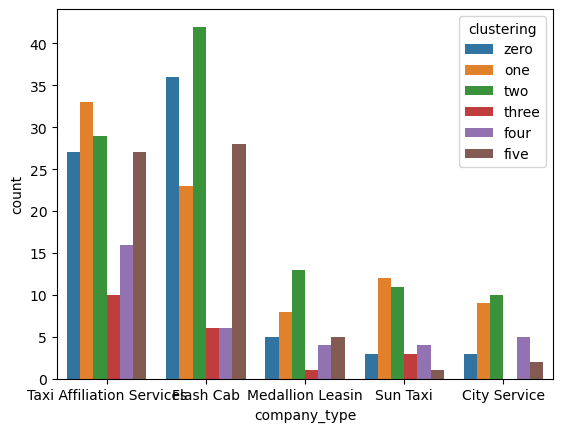

In [186]:
sns.countplot(x='company_type', hue='clustering', data=taxi_sample_retransformed, hue_order=numbers, order=taxi_sample_retransformed.company_type.value_counts().iloc[:5].index)

<AxesSubplot: xlabel='payment', ylabel='count'>

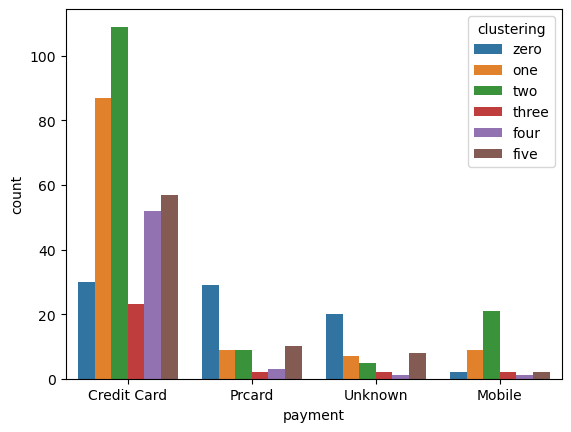

In [187]:
sns.countplot(x='payment', hue='clustering', data=taxi_sample_retransformed, hue_order=numbers, order=taxi_sample_retransformed.payment.value_counts().iloc[:10].index)

As already hinted above, we notice some interesting patterns.

__Nature Lovers__: Northwestern trip end region, no strong start region. Preference for starting and ending in the middle of the day, during the early week and in the summer. Noticeably longer trip duration, trip price and trip length and therefore likely to be city people wanting to get from the inner city to the outer city or nature. 

__Winter Commuters__: Start and end locations spread throughout northern and eastern city parts, very noticeable peak during the early months, small preference for fridays and large preference for middle of the day trips. Low starting temperatures explained due to early months. Short duration of trip. 

__Afternoon Commuters__: High number of trips in this cluster, spread throughout northern inner city, very noticeable peak in the afternoon and evening hours with basically no trips pre-noon. Preference for later months of the year. Short duration of trip.

__Bar Goers__: End locations spread throughout northern city, start locations more in northwestern part of the city. noticeable preference for later hours and later months of the year. Noticeably longer trip miles, trip length and trip total and a dual-peak in the week and on the weekend. 

__Morning Commuters__: Spread throughout northern and eastern part of the city, very noticeable preference for early morning trips, with basically no post-noon ones, throughout entire week, short duration of trips. 

__Southern City Residents__: Highly concentrated in the less frequented south of city with a preference for the non-weekend days and the middle of the day. 

## Results and Intepretation: Soft Clustering with GMMs

We also look at the clusters from our soft clustering and give them descriptive names.

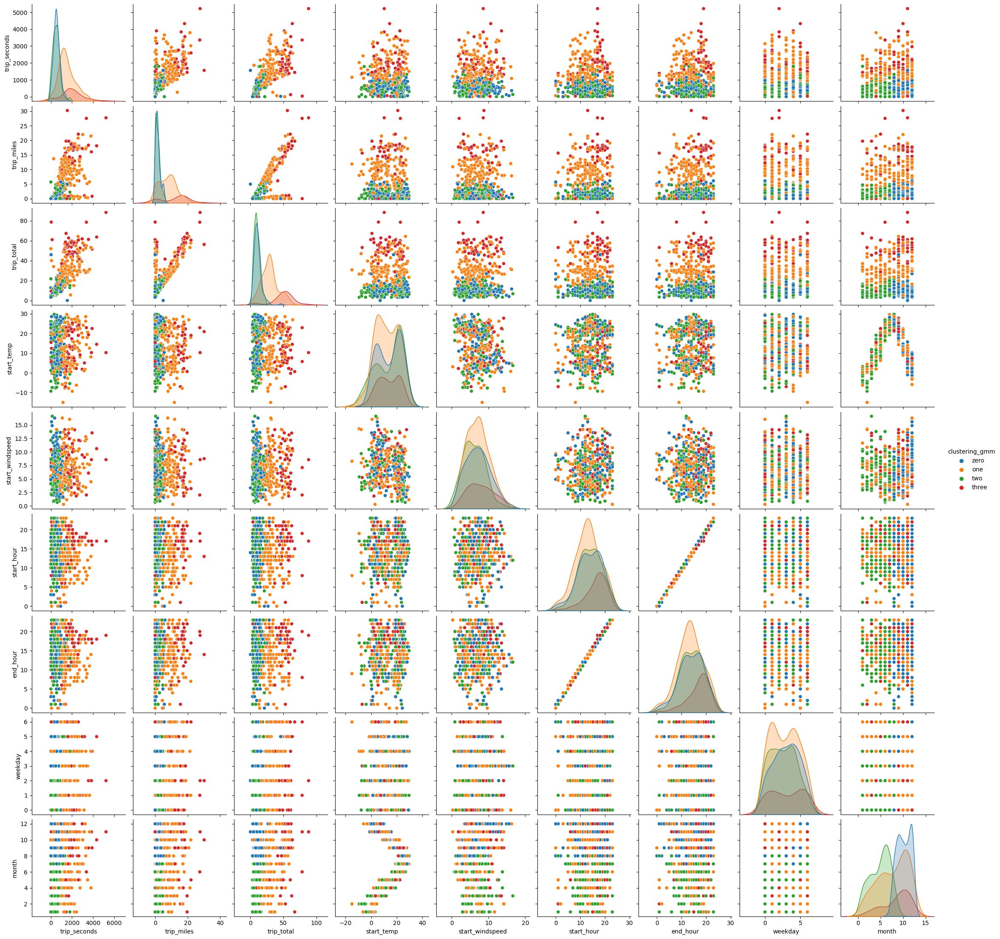

In [188]:
sns.pairplot(data=taxi_sample_retransformed[continuous_cols + ordinal_cols + ["clustering_gmm"]], hue="clustering_gmm", palette="tab10", hue_order=numbers[:4])

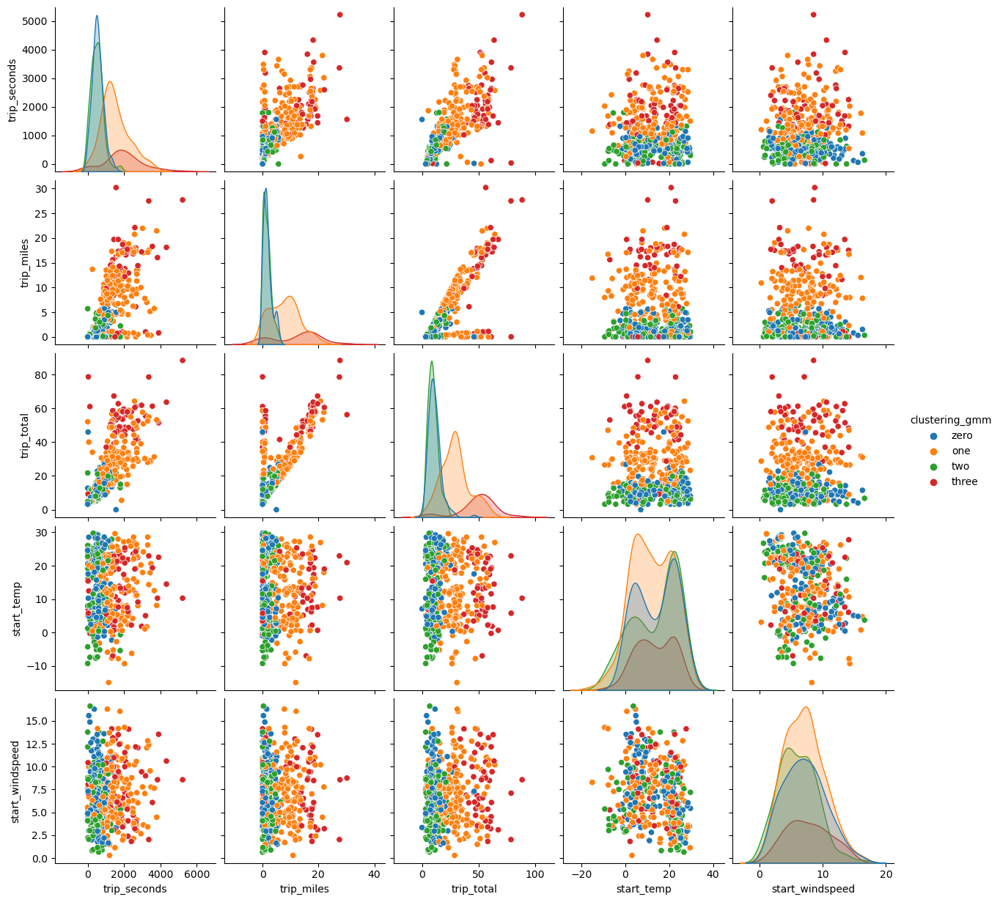

In [189]:
sns.pairplot(data=taxi_sample_retransformed[continuous_cols + ["clustering_gmm"]], hue="clustering_gmm", palette="tab10", hue_order=numbers[:4])

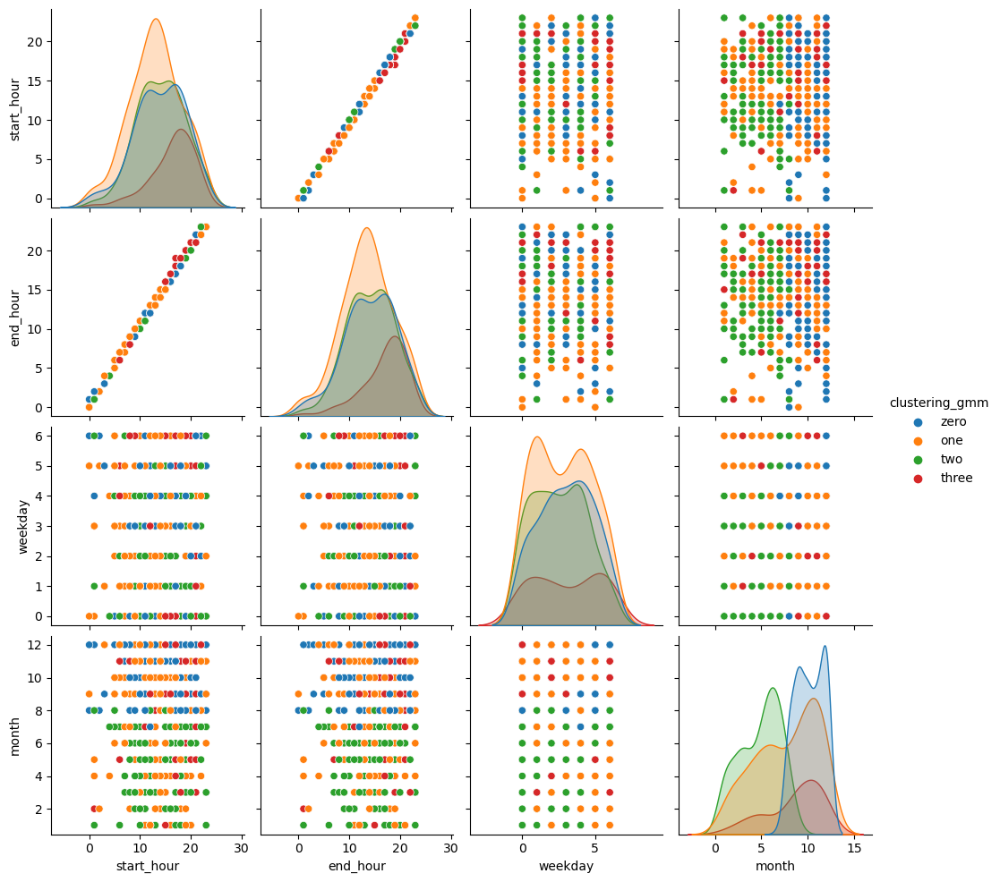

In [190]:
sns.pairplot(data=taxi_sample_retransformed[ordinal_cols + ["clustering_gmm"]], hue="clustering_gmm", palette="tab10", hue_order=numbers[:4])

In [191]:
taxi_sample_locations = taxi_sample_retransformed[["start_lat", "start_long", "clustering_gmm"]]
tmap = folium.Map(location=[taxi_sample_locations.start_lat.mean(), taxi_sample_locations.start_long.mean()], zoom_start=10, control_scale=True)
def plot_points(point):
    folium.CircleMarker(location=[point.start_lat, point.start_long],
                        radius=5,
                        weight=10,
                       color=colors[point.clustering_gmm]).add_to(tmap)
taxi_sample_locations.apply(plot_points, axis=1)
tmap

Note: "four" and "five" are in the legend but do not appear in this clustering. However without them the coloring scheme would not work.

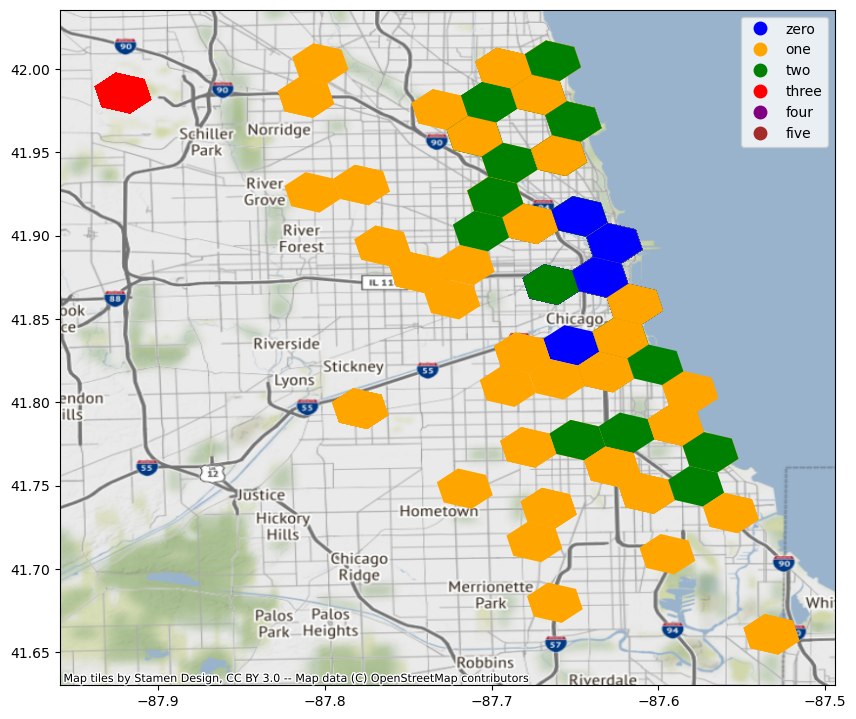

In [192]:
taxi_sample_retransformed_gpd = taxi_sample_retransformed.h3.geo_to_h3(lat_col="start_lat", lng_col="start_long", resolution=7)
taxi_sample_retransformed_gpd = taxi_sample_retransformed_gpd.h3.h3_to_geo_boundary()
ax = taxi_sample_retransformed_gpd.plot(legend=True, column="clustering_gmm", figsize=(10, 10), categories=numbers, cmap=cmap, missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

In [193]:
taxi_sample_locations = taxi_sample_retransformed[["end_lat", "end_long", "clustering_gmm"]]
tmap = folium.Map(location=[taxi_sample_locations.end_lat.mean(), taxi_sample_locations.end_long.mean()], zoom_start=10, control_scale=True)
def plot_points(point):
    folium.CircleMarker(location=[point.end_lat, point.end_long],
                        radius=5,
                        weight=10,
                       color=colors[point.clustering_gmm]).add_to(tmap)
taxi_sample_locations.apply(plot_points, axis=1)
tmap

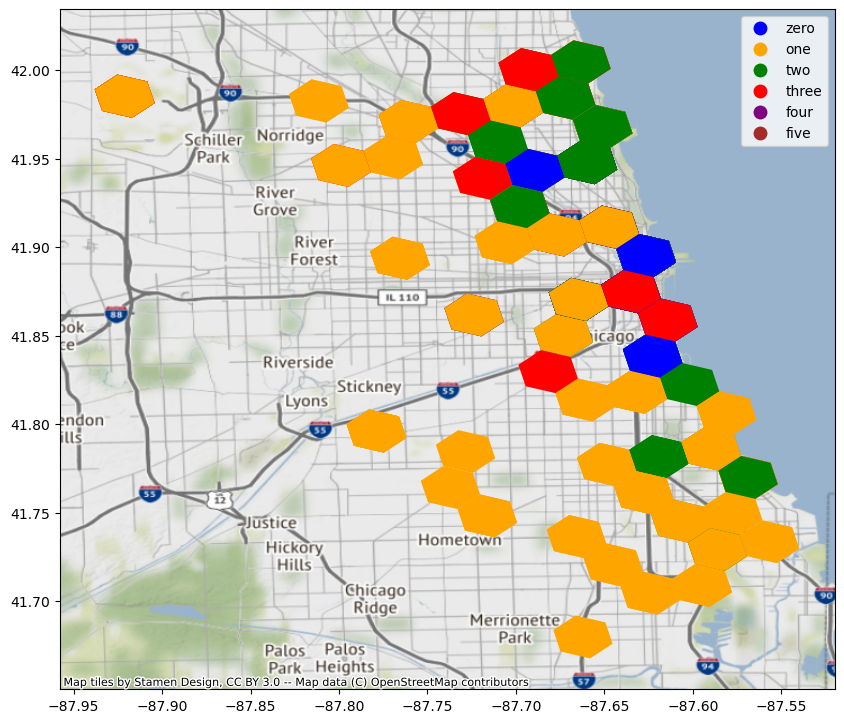

In [194]:
taxi_sample_retransformed_gpd = taxi_sample_retransformed.h3.geo_to_h3(lat_col="end_lat", lng_col="end_long", resolution=7)
taxi_sample_retransformed_gpd = taxi_sample_retransformed_gpd.h3.h3_to_geo_boundary()
ax = taxi_sample_retransformed_gpd.plot(legend=True, column="clustering_gmm", figsize=(10, 10), categories=numbers, cmap=cmap, missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs.to_string())

<AxesSubplot: xlabel='company_type', ylabel='count'>

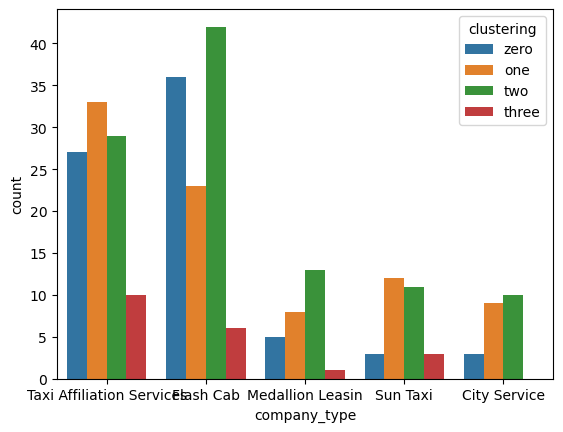

In [195]:
sns.countplot(x='company_type', hue='clustering', data=taxi_sample_retransformed, hue_order=numbers[:4], palette="tab10", order=taxi_sample_retransformed.company_type.value_counts().iloc[:5].index)

<AxesSubplot: xlabel='payment', ylabel='count'>

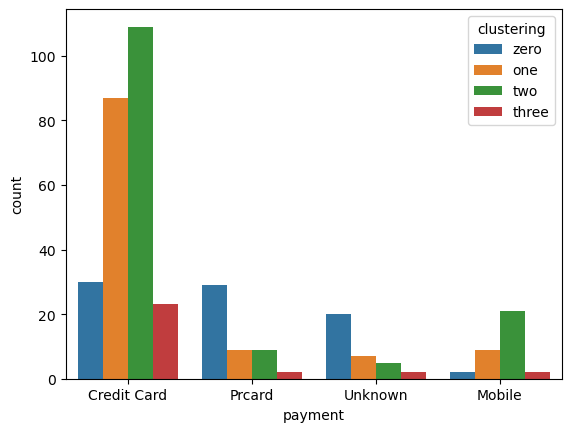

In [196]:
sns.countplot(x='payment', hue='clustering', data=taxi_sample_retransformed, hue_order=numbers[:4], order=taxi_sample_retransformed.payment.value_counts().iloc[:10].index)

Interestingly, there seem to be one big encompassing cluster in this soft clustering approach, one smaller but still broad cluster and two more or less specific ones. This approach also gives us the probabilities for each cluster, so we can actually see if this approach really formed "general" and "specific" clusters and our observation is correct, before we interpret them.

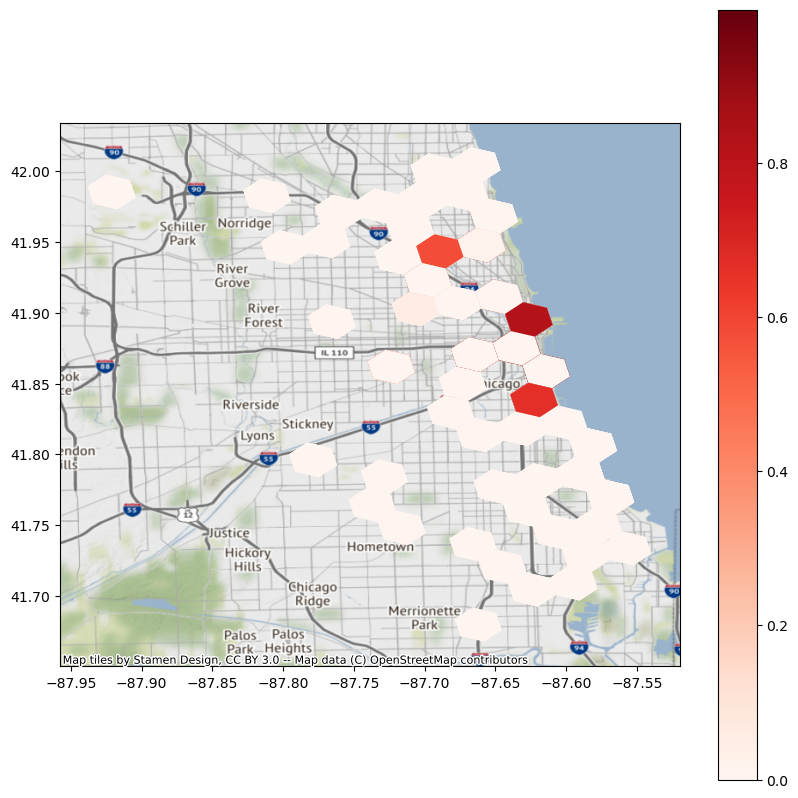

In [197]:
ax = taxi_sample_retransformed_gpd.reset_index().join(taxi_pca_500_probabilities).set_index("h3_07").plot(legend=True, cmap="Reds", column=0, figsize=(10, 10), missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

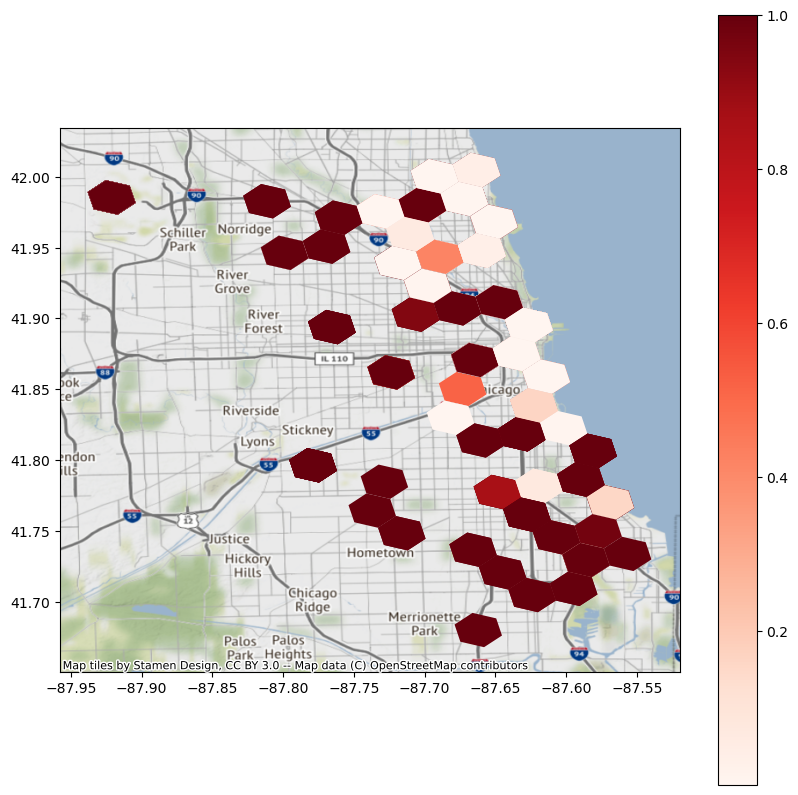

In [198]:
ax = taxi_sample_retransformed_gpd.reset_index().join(taxi_pca_500_probabilities).set_index("h3_07").plot(legend=True, cmap="Reds", column=1, figsize=(10, 10), missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

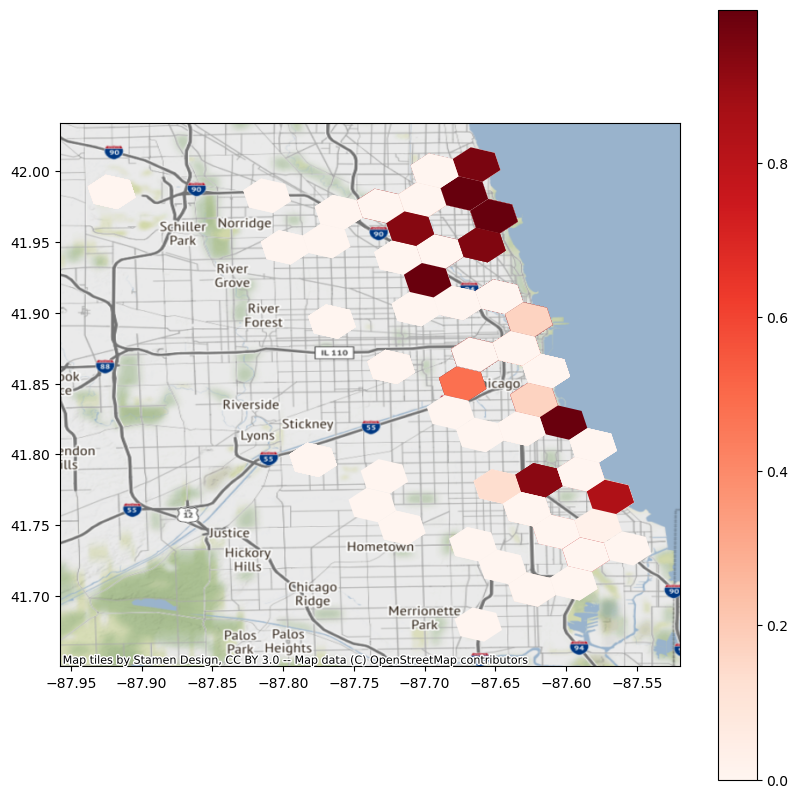

In [199]:
ax = taxi_sample_retransformed_gpd.reset_index().join(taxi_pca_500_probabilities).set_index("h3_07").plot(legend=True, cmap="Reds", column=2, figsize=(10, 10), missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

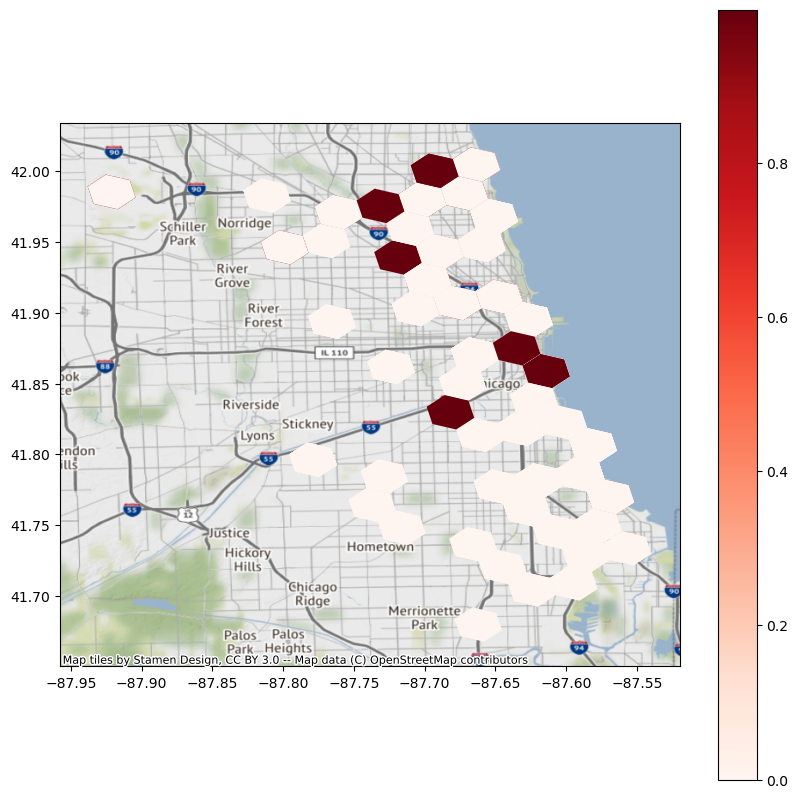

In [200]:
ax = taxi_sample_retransformed_gpd.reset_index().join(taxi_pca_500_probabilities).set_index("h3_07").plot(legend=True, cmap="Reds", column=3, figsize=(10, 10), missing_kwds = dict(color = "lightgrey",))
ctx.add_basemap(ax, crs=taxi_sample_retransformed_gpd.crs)

__Outer City Trips__: We can see here that there is a cluster that is actually very encompassing and also has a high probability for many other hexagons, meaning that it basically forms the bulk of the trips. 

__Core Inner City Trips__: Then there is a very specific cluster only containing the innermost city trips, with some probability for other highly frequented inner city hexagons.

__Inner City Trips__: The other cluster is semi-specific, containing mostly the inner western city.

__Late and Long Trips__: And then there is one cluster containing spread throughout the populated north that seems geographically divided, but is clustered together due to other features similarity, like the late starting hour and the noticeably longer trip duration as well as higher trip price.. Can also be reasonably estimated to be trips to bars and the nightlife.

## Kernel Density Estimation

Lastly, we want to use Kernel Density Estimation, which uses Gaussian Mixture Models (GMMs) to approximate a distribution, in our case of trips in an area. For that we first get our taxi data again and convert the h3_7 column to their centroid coordinate point

In [201]:
taxi_data_gpd = taxi_data.set_index("h3_7_pickup").h3.h3_to_geo()
taxi_data_gpd.head(5)

,index,trip_id,taxi_id,trip_start_timestamp,trip_end_timestamp,pickup_census_tract,dropoff_census_tract,pickup_community_area,dropoff_community_area,trip_seconds,...,h3_6_pickup,h3_6_dropoff,h3_7_dropoff,h3_8_pickup,h3_8_dropoff,start_hour,end_hour,weekday,month,geometry
h3_7_pickup,,,,,,,,,,,,,,,,,,,,,
872664c1effffff,0,505af6c6eb3cc5b3098f9c565af55e7ef6397d94,175a58299af3a8c883453259b9a0cfc45ccbbbe1a07883...,2021-01-01,2021-01-01 00:00:00,NaN,NaN,8.0,8.0,165.0,...,862664c1fffffff,862664c1fffffff,872664c1effffff,882664c1edfffff,882664c1edfffff,0,0,4,1,POINT (-87.62639 41.89540)
872664d99ffffff,1,b6a1c6f16a7f52cdfed0476891b7c8d58440011c,931225a382fc38a75212f9d358439aec0d9b50fdaf32ad...,2021-01-01,2021-01-01 00:45:00,NaN,NaN,14.0,22.0,2361.0,...,862664ca7ffffff,862664ca7ffffff,872664ca1ffffff,882664d993fffff,882664ca11fffff,0,0,4,1,POINT (-87.73117 41.97559)
872664c1effffff,2,a76c9cae097af5ff1dfef35b376a832f54d789ea,72920f6ebc5830d39039323cf78a316085444eb8f8b272...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,68.0,1800.0,...,862664c1fffffff,862664cc7ffffff,872664cc2ffffff,882664c1edfffff,882664cc2bfffff,0,0,4,1,POINT (-87.62639 41.89540)
872664520ffffff,3,11b01b6ac8d706e3fe522ee17d1cb7bae4851c45,be435bc4d6744155b3272e9edded016bd4afb347774701...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,56.0,75.0,1260.0,...,862664527ffffff,862664567ffffff,872664562ffffff,882664520bfffff,882664562dfffff,0,0,4,1,POINT (-87.77883 41.79623)
872664c1effffff,4,cdb55aa436f49734bec7dbe95605ef698819992d,a7aaa6374b9f88b5fd31a1106378dffccb77e1261bc57a...,2021-01-01,2021-01-01 00:30:00,NaN,NaN,8.0,1.0,1555.0,...,862664c1fffffff,862664d8fffffff,872664d8cffffff,882664c1edfffff,882664d8cdfffff,0,0,4,1,POINT (-87.62639 41.89540)


To not overload the estimation, we take a sample of 50000 data points from our dataset, which should be absolutely representative

In [202]:
taxi_data_gpd_sample_50000 = taxi_data_gpd.sample(50000, random_state=1)

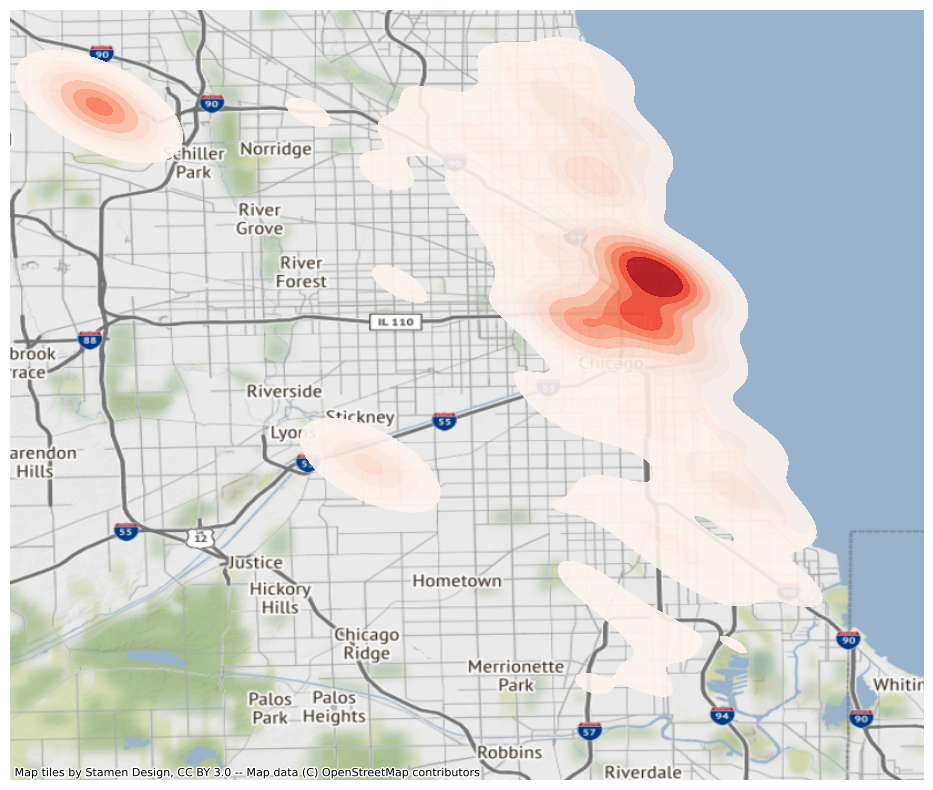

In [203]:
f, ax = plt.subplots(ncols=1, figsize=(20, 8))
kde = sns.kdeplot(
    ax=ax,
    x=taxi_data_gpd_sample_50000['geometry'].x,
    y= taxi_data_gpd_sample_50000['geometry'].y,
    shade=True,
    cmap='Reds',
    alpha=0.9
)
ctx.add_basemap(ax=ax,crs = taxi_data_gpd_sample_50000.crs.to_string())
ax.set_axis_off()
plt.tight_layout()

plt.show()

This Kernel Density Estimation confirms to us what we already suspected, most trip demand is located in the inner city, with some peaks further north as well as southeast and a distributed demand in the south. 

As trips out of the city boundaries are likely bundled up into the one noticeable district in the northeast, there is another peak there, but this is likely not actually true as the trips are probably spread out all around the city borders.